# Build dataset
- Import from Matlab files
- Build DataFrame with Time (for each frame), Behavior, Whisker, dF/F0, and events.
- Each plane gets its own behavior and whisker measures.
    - Mean or sum of behavior or whisker inputs between the end of the previous frame and the end of the current frame
        - If we use the beginning of frame time points instead of the end, then there can be some cases where (e.g.) touch happened during the frame acquisition, so that the bottom right cell might have responded to the touch, but the touch is assigned to the next frame, resulting in -1 frame as the response onset. 
    - To facilitate the calculation
        - Have each signal as DataFrame: calcium, whisker, and behavior - total 3 DataFrames per plane.
        - All timepoints relative to the onset of behavior time points.


In [21]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os, shutil, tqdm, glob, h5py, mat73, imageio, napari
import seaborn as sns
from pathlib import Path
from scipy.io import loadmat
from tqdm import notebook
from suite2p.io.binary import BinaryFile

# h5_dir_1 = Path('H:/')
# h5_dir_2 = Path('F:/')
# b_dir = Path('D:/SoloData/')
# w_dir = Path('D:/WhiskerVideo/')
h5_dir = Path('E:/TPM/JK/h5')
b_dir = Path('E:/TPM/JK/SoloData/')
w_dir = Path('E:/TPM/JK/WhiskerVideo/')

mice =          [25,    27,   30,   36,     37,     38,     39,     41,     52,     53,     54,     56]
# refSessions =   [4,     3,    3,    1,      7,      2,      1,      3,      3,      3,      3,      3]
# expSessions =   [19,    10,   21,   17,     0,      0,      23,     0,      21,     0,      0,      0]
# zoom =          [2,     2,    2,    1.7,    1.7,    1.7,    1.7,    1.7,    1.7,    1.7,    1.7,    1.7]
image_rate_list = [30.8359, 30.8359, 30.8359, 30.8359, 
                    24.2892, 24.2892, 24.2892, 24.2892,
                    30.8359, 30.8359, 30.8359, 30.8359] # from .mat file (sbx)
image_size_list = [[512,796], [512,796], [512,796], [512,796], 
                    [650,796], [650,796], [650,796], [650,796], 
                    [512,796], [512,796], [512,796], [512,796]] # from .mat file (sbx)

planes = range(1,9)

# mice =          [25,    27,   30,   36,     39,     52]
# refSessions =   [4,     3,    3,    1,      1,      3]
# expSessions =   [19,    10,   21,   17,     23,     21]
# zoom =          [2,     2,    2,    1.7,    1.7,    1.7]
# freq =          [7.7,   7.7,  7.7,  7.7,    6.1,    7.7]

In [5]:
w_data = mat73.loadmat(w_dir / 'JK025S01' / 'JK025S01_Whisker_Final_h5.mat')

In [7]:
list(w_data['hw'].keys())

['mouse_name', 'session_name', 'trials']

In [6]:
dict_keys = list(w_data['hw']['trials'][1].keys())
dict_keys

['amplitude',
 'arcLength',
 'kappaH',
 'kappaV',
 'midpoint',
 'phase',
 'phi',
 'poleAngle',
 'poleDistance',
 'poleMovingFrames',
 'polePosition',
 'poleUpFrames',
 'protractionSlide',
 'protractionSlideByWhisking',
 'protractionTFchunks',
 'protractionTFchunksByWhisking',
 'protractionTouchDuration',
 'protractionTouchDurationByWhisking',
 'retractionSlide',
 'retractionSlideByWhisking',
 'retractionTFchunks',
 'retractionTFchunksByWhisking',
 'retractionTouchDuration',
 'retractionTouchDurationByWhisking',
 'theta',
 'time',
 'trialNum',
 'whiskingStartFrames']

Now make the trials into DataFrames. <br>
Change 'time' to 'whisker_time'. <br>
Including mouse name and session name (just in case) <br>

In [6]:
dict_keys = list(w_data['hw']['trials'][1].keys())
whisker_df = pd.DataFrame(columns=dict_keys)
num_trials = len(w_data['hw']['trials'])
for i in range(num_trials):
    trial_data = w_data['hw']['trials'][i]
    trial_df = pd.DataFrame({})
    for key in dict_keys:
        trial_df[key] = [trial_data[key]]
    whisker_df = whisker_df.append(trial_df)
whisker_df['mouse_name'] = w_data['hw']['mouse_name']
whisker_df['session_name'] = w_data['hw']['session_name']
whisker_df.rename(columns={'time': 'whisker_time'}, inplace=True)
whisker_df['trialNum'] = whisker_df['trialNum'].astype(int)
whisker_df['poleAngle'] = whisker_df['poleAngle'].astype(int)
whisker_df['poleDistance'] = whisker_df['poleDistance'].astype(int)
whisker_df.set_index('trialNum', inplace=True)
whisker_df.head()

,amplitude,arcLength,kappaH,kappaV,midpoint,phase,phi,poleAngle,poleDistance,poleMovingFrames,...,retractionSlideByWhisking,retractionTFchunks,retractionTFchunksByWhisking,retractionTouchDuration,retractionTouchDurationByWhisking,theta,whisker_time,whiskingStartFrames,mouse_name,session_name
trialNum,,,,,,,,,,,,,,,,,,,,,
2,"[0.10420821390000796, 0.11305526443043801, 0.1...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.051683684603578924, 0.05053404980118735, 0....","[-0.06894776564429353, -0.06886128114623527, -...","[-19.41232582177878, -19.40196494041455, -19.3...","[1.400477775076968, 2.542826470635857, 3.00718...","[15.3466794316352, 15.20894284937983, 15.07754...",135,130000,"[450.0, 451.0, 452.0, 453.0, 454.0, 455.0, 456...",...,[],[],[],"[0, 0]","[0, 0]","[-19.400815531590297, -19.647260317468206, -19...","[0.0, 0.0032129546330805807, 0.006425909266161...","[122.0, 151.0, 172.0, 233.0, 259.0, 286.0, 312...",JK025,S01
3,"[0.36759030973674267, 0.48764529792832056, 0.4...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.0432780217916874, 0.04904859848875447, 0.04...","[-0.06711177492277562, -0.06768135304829884, -...","[-15.523011653801426, -15.546917003689876, -15...","[1.412222208948395, 1.9266671813323792, 2.4455...","[19.399922794081778, 19.080341934210594, 18.72...",45,130000,"[377.0, 378.0, 379.0, 380.0, 381.0, 382.0, 383...",...,[],[],[],"[0, 0]","[0, 0]","[-15.283340490970373, -15.663847476669766, -15...","[0.0, 0.0032129546330805807, 0.006425909266161...","[50.0, 70.0, 94.0, 107.0, 131.0, 158.0, 170.0,...",JK025,S01
4,"[1.2916012416639893, 2.069591222352205, 2.2400...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.04191067029345265, 0.038180774008623304, 0....","[-0.07100892445937503, -0.06739780359820152, -...","[-3.7666483169969647, -4.872865286782166, -5.9...","[1.2270636483106594, 1.6007493272165798, 1.812...","[12.30471681262978, 13.160935950372346, 13.037...",45,130000,"[377.0, 378.0, 379.0, 380.0, 381.0, 382.0, 383...",...,[],[],[],"[0, 0]","[0, 0]","[-1.2002628647889737, -3.58908242273043, -5.72...","[0.0, 0.0032129546330805807, 0.006425909266161...","[1.0, 12.0, 33.0, 46.0, 77.0, 124.0, 157.0, 19...",JK025,S01
5,"[0.6675380923373337, 1.216821028163149, 1.5493...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.059618282376724396, 0.05821000681834608, 0....","[-0.05902280621628363, -0.059188899121093305, ...","[-17.290307986802336, -17.371025244242126, -17...","[1.1268139455486923, 1.9781753070283916, 2.426...","[15.415831396568297, 15.918957587072594, 16.77...",135,130000,"[358.0, 359.0, 360.0, 361.0, 362.0, 363.0, 364...",...,[],[],[],"[0, 0]","[0, 0]","[-16.941363903005946, -17.34247503908168, -18....","[0.0, 0.0032129546330805807, 0.006425909266161...","[16.0, 571.0, 611.0, 651.0, 678.0, 1020.0, 108...",JK025,S01
6,"[0.04716637011246196, 0.15527580316392897, 0.2...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.049129977482566686, 0.04692079096347378, 0....","[-0.07250027242212548, -0.07055967420861638, -...","[-20.64313883221978, -20.630134264975773, -20....","[-1.0509372324537847, 2.5170591299539122, 2.98...","[15.263778804488156, 15.181936519269836, 15.27...",135,130000,"[358.0, 359.0, 360.0, 361.0, 362.0, 363.0, 364...",...,[],[],[],"[0, 0]","[0, 0]","[-20.554179021290626, -21.14363779054046, -20....","[0.0, 0.0032129546330805807, 0.006425909266161...","[363.0, 409.0, 435.0, 459.0, 469.0, 488.0, 503...",JK025,S01


In [ ]:
pkl_fn = w_dir / 'JK025S01' / 'JK025S01_whisker.pkl'
whisker_df.to_pickle(pkl_fn)


In [9]:
whisker_df = pd.read_pickle(pkl_fn)
whisker_df.head()

,amplitude,arcLength,kappaH,kappaV,midpoint,phase,phi,poleAngle,poleDistance,poleMovingFrames,...,retractionSlideByWhisking,retractionTFchunks,retractionTFchunksByWhisking,retractionTouchDuration,retractionTouchDurationByWhisking,theta,whisker_time,whiskingStartFrames,mouse_name,session_name
trialNum,,,,,,,,,,,,,,,,,,,,,
2,"[0.10420821390000796, 0.11305526443043801, 0.1...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.051683684603578924, 0.05053404980118735, 0....","[-0.06894776564429353, -0.06886128114623527, -...","[-19.41232582177878, -19.40196494041455, -19.3...","[1.400477775076968, 2.542826470635857, 3.00718...","[15.3466794316352, 15.20894284937983, 15.07754...",135,130000,"[450.0, 451.0, 452.0, 453.0, 454.0, 455.0, 456...",...,[],[],[],"[0, 0]","[0, 0]","[-19.400815531590297, -19.647260317468206, -19...","[0.0, 0.0032129546330805807, 0.006425909266161...","[148.0, 149.0, 150.0, 151.0, 152.0, 153.0, 154...",JK025,S01
3,"[0.36759030973674267, 0.48764529792832056, 0.4...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.0432780217916874, 0.04904859848875447, 0.04...","[-0.06711177492277562, -0.06768135304829884, -...","[-15.523011653801426, -15.546917003689876, -15...","[1.412222208948395, 1.9266671813323792, 2.4455...","[19.399922794081778, 19.080341934210594, 18.72...",45,130000,"[377.0, 378.0, 379.0, 380.0, 381.0, 382.0, 383...",...,[],[],[],"[0, 0]","[0, 0]","[-15.283340490970373, -15.663847476669766, -15...","[0.0, 0.0032129546330805807, 0.006425909266161...","[58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65....",JK025,S01
4,"[1.2916012416639893, 2.069591222352205, 2.2400...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.04191067029345265, 0.038180774008623304, 0....","[-0.07100892445937503, -0.06739780359820152, -...","[-3.7666483169969647, -4.872865286782166, -5.9...","[1.2270636483106594, 1.6007493272165798, 1.812...","[12.30471681262978, 13.160935950372346, 13.037...",45,130000,"[377.0, 378.0, 379.0, 380.0, 381.0, 382.0, 383...",...,[],[],[],"[0, 0]","[0, 0]","[-1.2002628647889737, -3.58908242273043, -5.72...","[0.0, 0.0032129546330805807, 0.006425909266161...","[4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12....",JK025,S01
5,"[0.6675380923373337, 1.216821028163149, 1.5493...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.059618282376724396, 0.05821000681834608, 0....","[-0.05902280621628363, -0.059188899121093305, ...","[-17.290307986802336, -17.371025244242126, -17...","[1.1268139455486923, 1.9781753070283916, 2.426...","[15.415831396568297, 15.918957587072594, 16.77...",135,130000,"[358.0, 359.0, 360.0, 361.0, 362.0, 363.0, 364...",...,[],[],[],"[0, 0]","[0, 0]","[-16.941363903005946, -17.34247503908168, -18....","[0.0, 0.0032129546330805807, 0.006425909266161...","[24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31....",JK025,S01
6,"[0.04716637011246196, 0.15527580316392897, 0.2...","[nan, nan, nan, nan, nan, nan, nan, nan, nan, ...","[0.049129977482566686, 0.04692079096347378, 0....","[-0.07250027242212548, -0.07055967420861638, -...","[-20.64313883221978, -20.630134264975773, -20....","[-1.0509372324537847, 2.5170591299539122, 2.98...","[15.263778804488156, 15.181936519269836, 15.27...",135,130000,"[358.0, 359.0, 360.0, 361.0, 362.0, 363.0, 364...",...,[],[],[],"[0, 0]","[0, 0]","[-20.554179021290626, -21.14363779054046, -20....","[0.0, 0.0032129546330805807, 0.006425909266161...","[403.0, 404.0, 405.0, 406.0, 407.0, 408.0, 409...",JK025,S01


# Build and save whisker DataFrame for all the sessions

In [ ]:
def build_whisker_dataframe(w_dir, session_folder):
    session_name = session_folder.split('\\')[-1]
    wf_fn = w_dir / session_name / f'{session_name}_whisker_final_h5.mat'
    whisker_pkl_fn = w_dir / session_name / f'{session_name}_whisker.pkl'
    # if not os.path.isfile(whisker_pkl_fn):
    if os.path.isfile(wf_fn):
        print(f'Processing {session_name}', flush=True)
        w_data = mat73.loadmat(wf_fn)
        print(f'{session_name} data loaded.', flush=True)
        dict_keys = list(w_data['hw']['trials'][1].keys())
        whisker_df = pd.DataFrame(columns=dict_keys)
        num_trials = len(w_data['hw']['trials'])
        for i in range(num_trials):
            trial_data = w_data['hw']['trials'][i]
            trial_df = pd.DataFrame({})
            for key in dict_keys:
                trial_df[key] = [trial_data[key]]
            whisker_df = whisker_df.append(trial_df)
        whisker_df['mouse_name'] = w_data['hw']['mouse_name']
        whisker_df['session_name'] = w_data['hw']['session_name']
        whisker_df.rename(columns={'time': 'whisker_time'}, inplace=True)
        whisker_df['trialNum'] = whisker_df['trialNum'].astype(int)
        whisker_df['poleAngle'] = whisker_df['poleAngle'].astype(int)
        whisker_df['poleDistance'] = whisker_df['poleDistance'].astype(int)
        whisker_df.set_index('trialNum', inplace=True)
        whisker_df.to_pickle(whisker_pkl_fn)
        print(f'{session_name} Done.', flush=True)

# for mouse in notebook.tqdm(mice):
#     session_folder_list = glob.glob(str(w_dir / f'JK{mouse:03d}S*'))
#     for session in session_folder_list:
#         build_whisker_dataframe(w_dir, session)
    
        
# All mice take about 3 hr without parallel

# Instead, use parallel (230107_build_whisker_dataframe_par.py)
# It takes about 20 min.

In [18]:
# Run single mouse for a test
mouse=52
session_folder_list = glob.glob(str(w_dir / f'JK{mouse:03d}S*'))
# for session_folder in notebook.tqdm(session_folder_list):
for session_folder in [session_folder_list[-1]]:
    session_name = session_folder.split('\\')[-1]
    wf_fn = w_dir / session_name / f'{session_name}_whisker_final_h5.mat'
    whisker_pkl_fn = w_dir / session_name / f'{session_name}_whisker.pkl'
    # if not os.path.isfile(whisker_pkl_fn):
    if os.path.isfile(wf_fn):
        w_data = mat73.loadmat(wf_fn)
        dict_keys = list(w_data['hw']['trials'][1].keys())
        whisker_df = pd.DataFrame(columns=dict_keys)
        num_trials = len(w_data['hw']['trials'])
        for i in range(num_trials):
            trial_data = w_data['hw']['trials'][i]
            trial_df = pd.DataFrame({})
            for key in dict_keys:
                trial_df[key] = [trial_data[key]]
            whisker_df = whisker_df.append(trial_df)
        whisker_df['mouse_name'] = w_data['hw']['mouse_name']
        whisker_df['session_name'] = w_data['hw']['session_name']
        whisker_df.rename(columns={'time': 'whisker_time'}, inplace=True)
        whisker_df['trialNum'] = whisker_df['trialNum'].astype(int)
        whisker_df['poleAngle'] = whisker_df['poleAngle'].astype(int)
        whisker_df['poleDistance'] = whisker_df['poleDistance'].astype(int)
        whisker_df.set_index('trialNum', inplace=True)
        whisker_df.to_pickle(whisker_pkl_fn)

### QC whisker dataframe
- by comparing length of parameters to whisker_time
- 'amplitude', 'arcLength', 'kappaH', 'kappaV', 'midpoint', 'phase', 'phi', 'theta'

In [3]:
mouse=25
session_folder_list = glob.glob(str(w_dir / f'JK{mouse:03d}S*'))
len(session_folder_list)

22

In [8]:
si = 0
session_folder = session_folder_list[si]
session_name = session_folder.split('\\')[-1]
whisker_pkl_fn = w_dir / session_name / f'{session_name}_whisker.pkl'
whisker_df = pd.read_pickle(whisker_pkl_fn)

all_vid_frame_parameters = ['amplitude', 'arcLength', 'kappaH', 'kappaV', 'midpoint', 'phase', 'phi', 'theta']
for trial_ind in range(len(whisker_df)):
    vid_len = len(whisker_df.iloc[trial_ind].whisker_time)
    all_param_len = np.zeros(len(all_vid_frame_parameters))
    for i, param in enumerate(all_vid_frame_parameters):
        param_len = len(whisker_df.iloc[trial_ind][param])
        all_param_len[i] = param_len
    if (all_param_len - vid_len).any():
        trial_num = whisker_df.index.values[trial_ind]
        mouse_name = whisker_df.iloc[trial_ind].mouse_name
        session_name = whisker_df.iloc[trial_ind].session_name
        print(f'Error in {mouse_name} {session_name} trial {trial_num} (index {trial_ind})')

In [5]:
session_name

'JK025S20'

In [ ]:
si = 21
session_folder = session_folder_list[si]
session_name = session_folder.split('\\')[-1]
whisker_pkl_fn = w_dir / session_name / f'{session_name}_whisker.pkl'
whisker_df = pd.read_pickle(whisker_pkl_fn)

all_vid_frame_parameters = ['amplitude', 'arcLength', 'kappaH', 'kappaV', 'midpoint', 'phase', 'phi', 'theta']

for trial_ind in range(len(whisker_df)):
    vid_len = len(whisker_df.iloc[trial_ind].whisker_time)
    all_param_nonan_len = np.zeros(len(all_vid_frame_parameters))
    for i, param in enumerate(all_vid_frame_parameters):
        param_nonan_len = len(np.where(np.isfinite(whisker_df.iloc[trial_ind][param]))[0])
        all_param_nonan_len[i] = param_nonan_len
    if (all_param_nonan_len - all_param_nonan_len[0]).any():
        trial_num = whisker_df.index.values[trial_ind]
        mouse_name = whisker_df.iloc[trial_ind].mouse_name
        session_name = whisker_df.iloc[trial_ind].session_name
        print(f'Nan length error in {mouse_name} {session_name} trial {trial_num} (index {trial_ind})')

In [148]:
trial_ind = 1
vid_len = len(whisker_df.iloc[trial_ind].whisker_time)
all_param_len = np.zeros(len(all_vid_frame_parameters))
for i, param in enumerate(all_vid_frame_parameters):
    param_len = len(whisker_df.iloc[trial_ind][param])
    all_param_len[i] = param_len
print(vid_len)
print(all_param_len)

1456
[1456.    2. 1456. 1456. 1456. 1456. 1456. 1456.]


In [ ]:
trial_ind = 1
vid_len = len(whisker_df.iloc[trial_ind].whisker_time)
all_param_nonan_len = np.zeros(len(all_vid_frame_parameters))
for i, param in enumerate(all_vid_frame_parameters):
    param_nonan_len = len(np.where(np.isfinite(whisker_df.iloc[trial_ind][param]))[0])
    all_param_nonan_len[i] = param_nonan_len
print(all_param_nonan_len)

In [54]:
# Run through all mice and sessions
all_vid_frame_parameters = ['amplitude', 'arcLength', 'kappaH', 'kappaV', 'midpoint', 'phase', 'phi', 'theta']

mouse_name_list = []
session_name_list = []
error_trials_list = []
empty_arc_length_trials_list = []
num_trials_list = []
for mouse in mice:
    session_folder_list = glob.glob(str(w_dir / f'JK{mouse:03d}S*'))
    mouse_name = f'JK{mouse:03d}'
    for session_folder in session_folder_list:
        session_name = session_folder.split('\\')[-1]
        whisker_pkl_fn = w_dir / session_name / f'{session_name}_whisker.pkl'
        if os.path.isfile(whisker_pkl_fn):
            whisker_df = pd.read_pickle(whisker_pkl_fn)
            error_trials = []
            empty_arc_length_trials = []
            num_trials_list.append(len(whisker_df))
            for trial_ind in range(len(whisker_df)):
                vid_len = len(whisker_df.iloc[trial_ind].whisker_time)
                all_param_len = np.zeros(len(all_vid_frame_parameters))
                for i, param in enumerate(all_vid_frame_parameters):
                    param_len = len(whisker_df.iloc[trial_ind][param])
                    all_param_len[i] = param_len
                if (all_param_len - vid_len).any():
                    trial_num = whisker_df.index.values[trial_ind]
                    error_trials.append(trial_num)
                if len(np.where(np.isfinite(whisker_df.iloc[trial_ind]['arcLength']))[0])==0:
                    trial_num = whisker_df.index.values[trial_ind]
                    empty_arc_length_trials.append(trial_num)
            mouse_name_list.append(mouse_name)
            session_name_list.append(session_name)
            error_trials_list.append(error_trials)
            empty_arc_length_trials_list.append(empty_arc_length_trials)
length_error_df = pd.DataFrame({'mouse_name': mouse_name_list,
            'session_name': session_name_list,
            'error_trials': error_trials_list,
            'empty_arc_length_trials': empty_arc_length_trials_list,
            'num_trials': num_trials_list})


In [48]:
# How many sessions?
error_session_num = len(np.where(length_error_df.error_trials.apply(len))[0])
whole_session_num = len(length_error_df)
print(f'{error_session_num} / {whole_session_num}')

0 / 294


### QC for arc length values
- There are whisker trials where arc length could not be calculated.
- Assigned NaN for these cases. 
### Look at the distribution of affected sessions and trials

In [49]:
# How many sessions? (out of 294)
len(np.where(length_error_df.empty_arc_length_trials.apply(len))[0])

209

In [50]:
np.max(length_error_df.empty_arc_length_trials.apply(len).values)

412

Text(0.5, 0, 'Proportion of trials missing arc length')

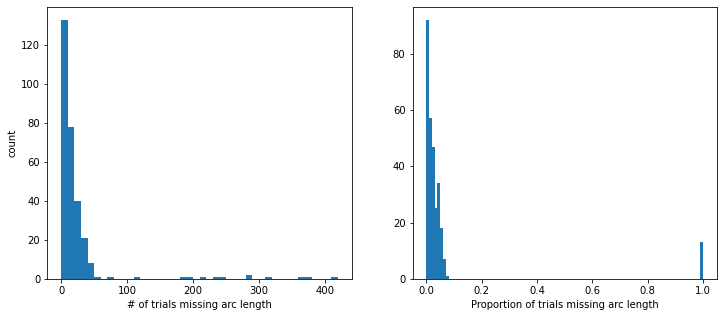

In [58]:
# How many trials in those nan length error sessions?
fig, ax = plt.subplots(1,2,figsize=(12,5))
ax[0].hist(length_error_df.empty_arc_length_trials.apply(len).values, bins=np.arange(0,430,10))
ax[0].set_xlabel('# of trials missing arc length')
ax[0].set_ylabel('count')
ax[1].hist(length_error_df.empty_arc_length_trials.apply(len).values / length_error_df.num_trials, bins = np.arange(0,1.01,0.01))
ax[1].set_xlabel('Proportion of trials missing arc length')

In [55]:
# Sessions having no arc length in > 100 trials

length_error_df[length_error_df.empty_arc_length_trials.apply(len)>50]

,mouse_name,session_name,error_trials,empty_arc_length_trials,num_trials
20,JK025,JK025S91,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",282
44,JK027,JK027S91,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",238
66,JK030,JK030S91,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",412
67,JK030,JK030S92,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",363
87,JK036,JK036S91,[],"[42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 5...",248
111,JK037,JK037S91,[],"[16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 2...",216
112,JK037,JK037S92,[],"[11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 2...",313
143,JK038,JK038S91,[],"[15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 2...",195
169,JK039,JK039S91,[],"[50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 6...",110
199,JK041,JK041S91,[],"[16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 2...",180


In [59]:
# sessions having no arc for ALL trials
length_error_df[length_error_df.empty_arc_length_trials.apply(len).values / length_error_df.num_trials == 1]

,mouse_name,session_name,error_trials,empty_arc_length_trials,num_trials
20,JK025,JK025S91,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",282
44,JK027,JK027S91,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",238
66,JK030,JK030S91,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",412
67,JK030,JK030S92,[],"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",363
87,JK036,JK036S91,[],"[42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 5...",248
111,JK037,JK037S91,[],"[16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 2...",216
112,JK037,JK037S92,[],"[11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 2...",313
143,JK038,JK038S91,[],"[15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 2...",195
169,JK039,JK039S91,[],"[50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 6...",110
199,JK041,JK041S91,[],"[16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 2...",180


# Correct this later. 
- Depending on the reason, this can be corrected by elongating extrapolation of the whisker fitting.
- Or, we might not need arc length fitting at all.
- Or, we might not even need whisker feature at all.
#
- Because all regular training sessions have >90% trials with arc length, let’s move on now.
- Revisit later if I really need to make it perfect.
- Some other trials might be from ‘catch’ trials (trialType=='oo'), where there was no pole available to mice.


# Now behavior DataFrame

In [441]:
mi = 0
mouse = mice[mi]
b_fn = b_dir / f'JK{mouse:03d}' / f'behavior_JK{mouse:03d}_h5.mat'
behavior_data = mat73.loadmat(b_fn)
behavior_data

{'hb': {'mouse_name': 'JK025',
  'sessions': [{'distractor': 'Off',
    'sessionName': 'S01',
    'sessionType': '2port-Discrim',
    'taskTarget': 'Angle',
    'trials': [{'answerLickTime': array([0, 0], dtype=uint64),
      'answerPeriodTime': array([2.551833, 3.55198 ]),
      'beamBreakTimesLeft': array([ 252.323834,  252.586651,  252.716817,  252.75715 ,  252.881665,
              253.070315,  253.274814,  253.828979,  254.999808,  259.737304,
              259.877788,  260.080136,  260.692618,  260.942117,  265.452099,
              265.659098,  266.629428,  266.889109,  267.076593,  267.252759,
              284.304857,  310.342253,  393.380754,  393.604935,  395.536745,
              395.652427,  395.844593,  407.854696,  408.025195,  408.236028,
              411.499348,  411.658363,  411.832862,  414.597836,  414.715669,
              414.892835,  415.092   ,  415.296333,  415.655014,  416.591828,
              416.762676,  416.926009,  417.65249 ,  418.219488,  418.242321,
 

In [442]:
behavior_data['hb']['sessions'][0]['trials'][0].keys()

dict_keys(['answerLickTime', 'answerPeriodTime', 'beamBreakTimesLeft', 'beamBreakTimesRight', 'choice', 'drinkingTime', 'extraITIOnErrorSetting', 'motorApPosition', 'motorDistance', 'poleDownOnsetTime', 'poleUpOnsetTime', 'rewardTimeLeft', 'rewardTimeRight', 'samplingPeriodTime', 'servoAngle', 'trialNum', 'trialType'])

In [450]:
np.size(behavior_data['hb']['sessions'][0]['trials'][0]['answerLickTime'])

2

In [456]:
keys = list(behavior_data['hb']['sessions'][0]['trials'][0].keys())
b_df = pd.DataFrame(columns=keys)
num_trials = len(behavior_data['hb']['sessions'][0]['trials'])
for ti in range(num_trials):
    trial_data = behavior_data['hb']['sessions'][0]['trials'][ti]
    trial_df = pd.DataFrame({})
    for key in keys:
        trial_df[key] = [trial_data[key]]
        if key == 'answerLickTime':
            if np.size(trial_data[key])==2:
                trial_df[key] = 0
        if key == 'beamBreakTimesLeft' or 'beamBreakTimesRight':
            if np.size(trial_data[key])==1:
                trial_df[key] = np.asarray(np.array([[trial_data[key]]]))
            elif (len(trial_data[key]) == 2 ) and (trial_data[key][0]==0) and (trial_data[key][1]==1):
                trial_df[key] = np.asarray(np.array([0]))
        
    b_df = b_df.append(trial_df)
print(len(b_df))
b_df.head()
b_df['mouse_name'] = behavior_data['hb']['mouse_name']
b_df['session_name'] = behavior_data['hb']['sessions'][0]['sessionName']
b_df['session_type'] = behavior_data['hb']['sessions'][0]['sessionType']
b_df['task_target'] = behavior_data['hb']['sessions'][0]['taskTarget']
b_df['distractor'] = behavior_data['hb']['sessions'][0]['distractor']
b_df['trialNum'] = b_df['trialNum'].astype(int)
b_df['servoAngle'] = b_df['servoAngle'].astype(int)
b_df['motorDistance'] = b_df['motorDistance'].astype(int)
b_df['motorApPosition'] = b_df['motorApPosition'].astype(int)
b_df.set_index('trialNum', inplace=True)
b_df.head()

614


,answerLickTime,answerPeriodTime,beamBreakTimesLeft,beamBreakTimesRight,choice,drinkingTime,extraITIOnErrorSetting,motorApPosition,motorDistance,poleDownOnsetTime,...,rewardTimeLeft,rewardTimeRight,samplingPeriodTime,servoAngle,trialType,mouse_name,session_name,session_type,task_target,distractor
trialNum,,,,,,,,,,,,,,,,,,,,,
1,0,"[2.551833, 3.55198]","[252.323834, 252.58665100000002, 252.716817, 2...","[254.79730800000002, 409.97037, 416.1704959999...",m,"[0, 0]",0.0,35000,100000,3.551980,...,"[0, 0]","[0, 0]","[1.051657, 2.551833]",135,ln,JK025,S01,2port-Discrim,Angle,Off
2,2.621974,"[2.5523079999998117, 2.621973999999909]","[1.0996470000000045, 1.3511459999999715, 2.357...",1.89666,l,"[2.732140999999956, 3.7323189999999613]",0.0,65648,130000,3.732319,...,"[2.621973999999909, 2.732140999999956]","[0, 0]","[1.0521469999998772, 2.5523079999998117]",135,ln,JK025,S01,2port-Discrim,Angle,Off
3,2.78314,"[2.5529740000001766, 2.783140000000003]","[0.3506489999999758, 0.7413300000000618, 1.325...",0,l,"[0, 0]",0.0,63826,130000,2.793322,...,"[0, 0]","[0, 0]","[1.0528289999999743, 2.5529740000001766]",45,rn,JK025,S01,2port-Discrim,Angle,Off
4,0,"[2.552662000000055, 3.5526680000000397]","[0.0161830000001828, 0.21834800000010546, 0.49...","[4.0766510000000835, 4.191332000000102, 4.3148...",m,"[0, 0]",0.0,61361,130000,3.552668,...,"[0, 0]","[0, 0]","[1.0524960000000192, 2.552662000000055]",45,rn,JK025,S01,2port-Discrim,Angle,Off
5,0,"[2.5531570000000556, 3.5533190000001014]","[0.0019999999999527063, 1.9399920000000748, 1....",4.052817,m,"[0, 0]",0.0,60919,130000,3.553319,...,"[0, 0]","[0, 0]","[1.0529959999998937, 2.5531570000000556]",135,ln,JK025,S01,2port-Discrim,Angle,Off


In [464]:
b_df.iloc[3].beamBreakTimesRight

array([4.076651, 4.191332, 4.314817, 4.563982, 4.563982, 4.784663])

# Run all mice

In [43]:
for mouse in notebook.tqdm(mice):
    b_fn = b_dir / f'JK{mouse:03d}' / f'behavior_JK{mouse:03d}_h5.mat'
    if os.path.isfile(b_fn):
        behavior_data = mat73.loadmat(b_fn)

        num_sessions = len(behavior_data['hb']['sessions'])
        mouse_name = behavior_data['hb']['mouse_name']
        for si in range(num_sessions):
            session_name = behavior_data['hb']['sessions'][si]['sessionName']
            if 'pre' in session_name:
                pre_session_num = session_name.split('pre')[1]
                session_name = f'S9{pre_session_num}'
            b_session_pkl_fn = b_dir / f'JK{mouse:03d}' / f'{mouse_name}{session_name}_behavior.pkl'
            # if not os.path.isfile(b_session_pkl_fn):
            keys = list(behavior_data['hb']['sessions'][si]['trials'][0].keys())    
            b_df = pd.DataFrame(columns=keys)
            num_trials = len(behavior_data['hb']['sessions'][si]['trials'])
            for ti in range(num_trials):
                trial_data = behavior_data['hb']['sessions'][si]['trials'][ti]
                trial_df = pd.DataFrame({})
                for key in keys:
                    trial_df[key] = [trial_data[key]]
                    if key == 'answerLickTime':
                        if np.size(trial_data[key])==2:
                            trial_df[key] = 0
                    if key == 'beamBreakTimesLeft' or 'beamBreakTimesRight':
                        if np.size(trial_data[key])==1:
                            trial_df[key] = np.asarray(np.array([[trial_data[key]]]))
                        elif (len(trial_data[key]) == 2 ) and (trial_data[key][0]==0) and (trial_data[key][1]==1):
                            trial_df[key] = np.asarray(np.array([0]))
                b_df = b_df.append(trial_df)
            b_df['mouse_name'] = mouse_name
            b_df['session_name'] = behavior_data['hb']['sessions'][si]['sessionName']
            b_df['session_type'] = behavior_data['hb']['sessions'][si]['sessionType']
            b_df['task_target'] = behavior_data['hb']['sessions'][si]['taskTarget']
            b_df['distractor'] = behavior_data['hb']['sessions'][si]['distractor']
            b_df['trialNum'] = b_df['trialNum'].astype(int)
            b_df['servoAngle'] = b_df['servoAngle'].astype(int)
            b_df['motorDistance'] = b_df['motorDistance'].astype(int)
            b_df['motorApPosition'] = b_df['motorApPosition'].astype(int)
            b_df.set_index('trialNum', inplace=True)

            b_df.to_pickle(b_session_pkl_fn)
# All mice takes about 63 min

  0%|          | 0/12 [00:00<?, ?it/s]

### QC behavior DataFrame
-  by comparing trial numbers between those in mat file and pkl file

In [44]:
# load mat file (by mouse)
mouse = 25
b_fn = b_dir / f'JK{mouse:03d}' / f'behavior_JK{mouse:03d}_h5.mat'
behavior_data = mat73.loadmat(b_fn)

# print sessions numbers
print([x['sessionName'] for x in behavior_data['hb']['sessions']])

[{'distractor': 'Off', 'sessionName': 'S01', 'sessionType': '2port-Discrim', 'taskTarget': 'Angle', 'trials': [{'answerLickTime': array([0, 0], dtype=uint64), 'answerPeriodTime': array([2.551833, 3.55198 ]), 'beamBreakTimesLeft': array([ 252.323834,  252.586651,  252.716817,  252.75715 ,  252.881665,
        253.070315,  253.274814,  253.828979,  254.999808,  259.737304,
        259.877788,  260.080136,  260.692618,  260.942117,  265.452099,
        265.659098,  266.629428,  266.889109,  267.076593,  267.252759,
        284.304857,  310.342253,  393.380754,  393.604935,  395.536745,
        395.652427,  395.844593,  407.854696,  408.025195,  408.236028,
        411.499348,  411.658363,  411.832862,  414.597836,  414.715669,
        414.892835,  415.092   ,  415.296333,  415.655014,  416.591828,
        416.762676,  416.926009,  417.65249 ,  418.219488,  418.242321,
        418.598653,  418.780319,  419.676815,  419.873663,  420.054647,
        420.25698 ,  420.697311,  420.849977,  421

['S01', 'S02', 'S03', 'S04', 'S05', 'S06', 'S07', 'S08', 'S09', 'S10', 'S11', 'S12', 'S13', 'S14', 'S15', 'S16', 'S17', 'S18', 'S19', 'S20', 'S21', 'S22', 'S23', 'S24', 'S25', 'pre1']


In [49]:
# Load a seesion pkl file
# And compare with mat file (behavior_data)

session_name = 'S06'
mat_session_names = [x['sessionName'] for x in behavior_data['hb']['sessions']]
mat_session_index = np.where([msn==session_name for msn in mat_session_names])[0][0]
mat_trial_nums = np.array([trial['trialNum'] for trial in behavior_data['hb']['sessions'][mat_session_index]['trials']])

if 'pre' in session_name:
    pre_session_num = session_name.split('pre')[1]
    session_name = f'S9{pre_session_num}'
    
mouse_name = behavior_data['hb']['mouse_name']
b_session_pkl_fn = b_dir / f'JK{mouse:03d}' / f'{mouse_name}{session_name}_behavior.pkl'

b_df = pd.read_pickle(b_session_pkl_fn)

pkl_trial_nums = b_df.index.values

np.array_equiv(mat_trial_nums, pkl_trial_nums)


True

In [50]:
# Compare all mice and sessions automatically
for mouse in mice:
    b_fn = b_dir / f'JK{mouse:03d}' / f'behavior_JK{mouse:03d}_h5.mat'
    behavior_data = mat73.loadmat(b_fn)
    
    num_sessions = len(behavior_data['hb']['sessions'])
    mouse_name = behavior_data['hb']['mouse_name']
    for si in range(num_sessions):
        mat_trial_nums = np.array([trial['trialNum'] for trial in behavior_data['hb']['sessions'][si]['trials']])
        session_name = behavior_data['hb']['sessions'][si]['sessionName']
        if 'pre' in session_name:
            pre_session_num = session_name.split('pre')[1]
            session_name = f'S9{pre_session_num}'
        b_session_pkl_fn = b_dir / f'JK{mouse:03d}' / f'{mouse_name}{session_name}_behavior.pkl'

        b_df = pd.read_pickle(b_session_pkl_fn)
        pkl_trial_nums = b_df.index.values

        if not np.array_equiv(mat_trial_nums, pkl_trial_nums):
            print(f'Error in {mouse_name} {session_name}')



# Now calcium data - frame time
- Only for the first 3 expert mice for now (2023/01/08)
- The rest of expert mice needs ROI curation
- The non-expert mice needs session-to-session registration

# !###############################

# VERY IMPORTANT FRAME TIMING CALCULATION

# !###############################

## Per session, then per plane
- Break down into trials
- Calcualte frame start and end time
- First generate frame information DataFrame.
- Then, merge with whisker and behavior DataFrame.
- Then, merge with neuronal activity.

In [8]:
expert_mice_ind = [0,1,2,3,6,8]

plane_len_mismatch_session_tuples = []
for emi in range(3,len(expert_mice_ind)):
    mi = expert_mice_ind[emi]
    # if emi < 3:
    #     h5_dir = h5_dir_1
    # else:
    #     h5_dir = h5_dir_2
    mouse = mice[mi]
    image_rate = image_rate_list[mi]
    image_size = image_size_list[mi]

    for top_plane_ind in [0,4]: # 0 or 4
        plane = planes[top_plane_ind]
        plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
        sts_reg = np.load(plane_dir / f'JK{mouse:03d}_plane{plane}_session_to_session_registration.npy', allow_pickle=True).item()
        session_nums = sts_reg['selected_session_num']
        # This info is valid in pi:pi+4

        for session_num in session_nums:
            trial_start_end = []
            plane_frames = [[],[],[],[]] # 4 planes per volume
            ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
            for fn in ophys_trial_fn_list:
                ophys_trial = loadmat(fn, simplify_cells=True)
                trial_start_end.extend(ophys_trial['trials'])
                for pi in range(4):
                    plane_frames[pi].extend(ophys_trial['frame_to_use'][top_plane_ind + pi]) # Very critical to have top_plane_ind added to pi (plane index)

            # Exception to handle I/O error from BControl
            if (mouse == 27) and (session_num == 12):
                trial_start_end = trial_start_end[:-1]

            plane_df_list = [pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']), # trial_duration for trial length QC
                            pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                            pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                            pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index'])]
            try:
                for trial in trial_start_end:
                    trial_num = trial['trialnum']
                    if np.isfinite(trial_num): # there was a case where trialnum was NaN, and corresponding frames were > 2000 frames in len
                        # Happened only in 025_006_000.trials (d230104_trial_num_nan_check.m)
                        # Not checked for non-experts.
                        # Add frame index (index of frame_to_use)
                        # Does not need to remove corresponding frames from calcium data, because frame_to_use were collected by matching 'trialnum', so
                        # 'NaN' trialnum were not assigned.
                        # Thus, total # of rows in the dataframe matches to the last frame index.
                        trial_start_frame = trial['frames'][0]
                        trial_end_frame = trial['frames'][1]
                        trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
                        trial_end_line = trial['lines'][1]
                        # Find indice for this trial from the plane
                        plane_frame_inds_trial = []
                        for pi in range(4):
                            plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
                        len_frames = np.array([len(f) for f in plane_frame_inds_trial])
                        assert (len_frames[1:] - len_frames[0]).any() == False # to confirm that each plane shared the same # of frames

                        # Make per trial DataFrame in each plane
                        for pi in range(4):
                            # Calculate start and end time for each frame
                            plane_frame_trial = np.asarray(plane_frames[pi])[plane_frame_inds_trial[pi]]
                            start_tmp = list((plane_frame_trial - trial_start_frame + (trial_start_line - 1) / image_size[0]) / image_rate)
                            end_tmp = list((plane_frame_trial - trial_start_frame + 1 + (trial_start_line - 1) / image_size[0]) / image_rate) #
                                # end_time should include the end of the last line 
                                # It matches to the next frame (next plane) start time
                                # TTL signal is assumed to have arrived at the beginning of the line
                            trial_df_tmp = pd.DataFrame()
                            trial_df_tmp['frame_start_time'] = start_tmp
                            trial_df_tmp['frame_end_time'] = end_tmp
                            trial_df_tmp['trialNum'] = trial_num
                            # Calculate trial duration
                            trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
                            trial_df_tmp['trial_duration'] = trial_duration
                            trial_df_tmp['frame_index'] = plane_frame_inds_trial[pi]

                            plane_df_list[pi] = plane_df_list[pi].append(trial_df_tmp)
                # Reset index for all the frames and save to pkl file
                for pi in range(4):
                    plane_df_list[pi].reset_index(drop=True, inplace=True)
                    plane = planes[top_plane_ind+pi]
                    plane_dir= h5_dir / f'{mouse:03d}' / f'plane_{plane}' 
                    pkl_fn =  f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
                    plane_df_list[pi].to_pickle(plane_dir / pkl_fn)
            except:
                plane_len_mismatch_session_tuples.append((mouse, session_num, top_plane_ind+1))
# JK025,027,030 took about 20 min
# JK036, 039, 052 took about 27 min

C:\Users\shires\AppData\Local\Temp/ipykernel_17884/1871547993.py:74: RuntimeWarning: overflow encountered in ushort_scalars
  trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
C:\Users\shires\AppData\Local\Temp/ipykernel_17884/1871547993.py:74: RuntimeWarning: overflow encountered in ubyte_scalars
  trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate


In [3]:
len_frames 

array([65, 64, 65, 65])

## There is a case where length of frames across planes do not match
- e.g., JK036 S010 planes 5-8
- See how many fails this (from JK036, 039, and 052)
- If not in so many trials, might be easier to just remove that trial

In [9]:
plane_len_mismatch_session_tuples

[(36, 10, 1),
 (36, 13, 1),
 (36, 10, 5),
 (36, 13, 5),
 (39, 18, 1),
 (39, 901, 1),
 (39, 18, 5),
 (39, 901, 5)]

In [10]:
# How many trials in each of these volumes?
error_session_error_trials = []
for session_tuple in plane_len_mismatch_session_tuples:
    mouse = session_tuple[0]
    session_num = session_tuple[1]
    top_plane_ind = session_tuple[2]-1
    
    trial_start_end = []
    plane_frames = [[],[],[],[]] # 4 planes per volume
    ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
    for fn in ophys_trial_fn_list:
        ophys_trial = loadmat(fn, simplify_cells=True)
        trial_start_end.extend(ophys_trial['trials'])
        for pi in range(4):
            plane_frames[pi].extend(ophys_trial['frame_to_use'][top_plane_ind + pi]) # Very critical to have top_plane_ind added to pi (plane index)

    # Exception to handle I/O error from BControl
    if (mouse == 27) and (session_num == 12):
        trial_start_end = trial_start_end[:-1]

    plane_df_list = [pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']), # trial_duration for trial length QC
                    pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                    pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                    pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index'])]
    error_trial = []
    for trial in trial_start_end:
        trial_num = trial['trialnum']
        if np.isfinite(trial_num): # there was a case where trialnum was NaN, and corresponding frames were > 2000 frames in len
            # Happened only in 025_006_000.trials (d230104_trial_num_nan_check.m)
            # Not checked for non-experts.
            # Add frame index (index of frame_to_use)
            # Does not need to remove corresponding frames from calcium data, because frame_to_use were collected by matching 'trialnum', so
            # 'NaN' trialnum were not assigned.
            # Thus, total # of rows in the dataframe matches to the last frame index.
            trial_start_frame = trial['frames'][0]
            trial_end_frame = trial['frames'][1]
            trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
            trial_end_line = trial['lines'][1]
            # Find indice for this trial from the plane
            plane_frame_inds_trial = []
            for pi in range(4):
                plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
            len_frames = np.array([len(f) for f in plane_frame_inds_trial])
            if (len_frames[1:] - len_frames[0]).any() == True:
                error_trial.append(trial_num)

    error_session_error_trials.append(error_trial)

In [12]:
[len(et) for et in error_session_error_trials]

[61, 30, 63, 22, 160, 96, 156, 64]

# trials file error in 036 S10, S13, 039 S18, S901
- File split errors
- Investigate in MATLAB
## All these were from multiple .trials files
- Should be an error during merging

## First, check the number of frames from h5 files and data.bin

In [18]:
sti = 0 
session_tuple = plane_len_mismatch_session_tuples[sti]
mouse = session_tuple[0]
session_num = session_tuple[1]
plane = session_tuple[2]



In [20]:
plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
h5_fns = glob.glob(str(plane_dir / f'{mouse:03d}_{session_num:03d}_0*_plane_{plane}.h5'))
num_frames = np.zeros(len(h5_fns))
for i in range(len(h5_fns)):
    h5_fn = h5_fns[i]
    with h5py.File(h5_fn, 'r') as f:
        num_frames[i] = f['data'].shape[0]
print(num_frames)

[1702. 7903.]


In [23]:
databin_fn = plane_dir / f'{session_num:03}' / 'plane0' / 'data.bin'
ops = np.load(plane_dir / f'{session_num:03}' / 'plane0' / 'ops.npy', allow_pickle=True).item()
Ly = ops['Ly']
Lx = ops['Lx']
bin_file = BinaryFile(Ly=Ly, Lx=Lx, read_filename=databin_fn)

In [24]:
bin_file.n_frames

9605

In [25]:
sum(num_frames)

9605.0

In [27]:
# do it for all files
def check_num_frames_match(mouse, session_num, plane):
    plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
    h5_fns = glob.glob(str(plane_dir / f'{mouse:03d}_{session_num:03d}_0*_plane_{plane}.h5'))
    num_frames = 0
    for i in range(len(h5_fns)):
        h5_fn = h5_fns[i]
        with h5py.File(h5_fn, 'r') as f:
            num_frames += f['data'].shape[0]
    databin_fn = plane_dir / f'{session_num:03}' / 'plane0' / 'data.bin'
    ops = np.load(plane_dir / f'{session_num:03}' / 'plane0' / 'ops.npy', allow_pickle=True).item()
    Ly = ops['Ly']
    Lx = ops['Lx']
    bin_file = BinaryFile(Ly=Ly, Lx=Lx, read_filename=databin_fn)

    return num_frames == bin_file.n_frames

for session_tuple in plane_len_mismatch_session_tuples:
    mouse = session_tuple[0]
    session_num = session_tuple[1]
    top_plane = session_tuple[2]
    for plane in range(top_plane, top_plane+4):
        print(check_num_frames_match(mouse, session_num, plane))

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False


### First half of error sessions has correct number of frames
- The rest do not.
- JK036 VS JK039
### Why does JK039 error sessions have mismatch?

In [35]:
sti = 7
session_tuple = plane_len_mismatch_session_tuples[sti]
mouse = session_tuple[0]
session_num = session_tuple[1]
plane = session_tuple[2]

plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
h5_fns = glob.glob(str(plane_dir / f'{mouse:03d}_{session_num:03d}_0*_plane_{plane}.h5'))
num_frames = np.zeros(len(h5_fns))
for i in range(len(h5_fns)):
    h5_fn = h5_fns[i]
    with h5py.File(h5_fn, 'r') as f:
        num_frames[i] = f['data'].shape[0]
print(num_frames)

databin_fn = plane_dir / f'{session_num:03}' / 'plane0' / 'data.bin'
ops = np.load(plane_dir / f'{session_num:03}' / 'plane0' / 'ops.npy', allow_pickle=True).item()
Ly = ops['Ly']
Lx = ops['Lx']
bin_file = BinaryFile(Ly=Ly, Lx=Lx, read_filename=databin_fn)
print(bin_file.n_frames)

[1147. 2022.]
1147


## JK039 had only the first file
- Looking at the behavior note - just use the first half for these sessions
- 901 session not even necessary (had uneven upper and lower volume imaging duration)
## Focus on JK036 sessions
- Frame numbers match between h5 and data.bin files
- Check the frame numbers from .trials file

In [52]:
sti = 3
session_tuple = plane_len_mismatch_session_tuples[sti]
mouse = session_tuple[0]
session_num = session_tuple[1]
plane = session_tuple[2]

plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'

trial_start_end = []
plane_frames = [[],[],[],[]] # 4 planes per volume
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
for fn in ophys_trial_fn_list:
    ophys_trial = loadmat(fn, simplify_cells=True)
    trial_start_end.extend(ophys_trial['trials'])
    for pi in range(4):
        plane_frames[pi].extend(ophys_trial['frame_to_use'][plane-1+pi]) # Very critical to have top_plane_ind added to pi (plane index)


h5_fns = glob.glob(str(plane_dir / f'{mouse:03d}_{session_num:03d}_0*_plane_{plane}.h5'))
num_frames = np.zeros(len(h5_fns))
for i in range(len(h5_fns)):
    h5_fn = h5_fns[i]
    with h5py.File(h5_fn, 'r') as f:
        num_frames[i] = f['data'].shape[0]

len(plane_frames[0]) == sum(num_frames)


True

## Just add max + 1000 of previous frame_to_use
- when adding the next one
- The rest will be taken care of because of indexing
- Also to the ophys_trial['trials'][x]['frames']

In [56]:
plane_len_mismatch_session_tuples[:4]

[(36, 10, 1), (36, 13, 1), (36, 10, 5), (36, 13, 5)]

In [58]:
np.max([max(pf) for pf in plane_frames])

114307

In [59]:
ophys_trial['frame_to_use']

array([array([  2043,   2047,   2051, ..., 114591, 114595, 114599]),
       array([  2042,   2046,   2050, ..., 114590, 114594, 114598]),
       array([  2041,   2045,   2049, ..., 114589, 114593, 114597]),
       array([  2040,   2044,   2048, ..., 114588, 114592, 114596]),
       array([    63,     67,     71, ..., 114299, 114303, 114307]),
       array([    62,     66,     70, ..., 114298, 114302, 114306]),
       array([    61,     65,     69, ..., 114297, 114301, 114305]),
       array([    60,     64,     68, ..., 114296, 114300, 114304])],
      dtype=object)

In [62]:
ophys_trial['trials'][0]['frames']

array([ 59, 193], dtype=uint8)

In [65]:
ophys_trial['frame_to_use'][0]+1000

array([  3043,   3047,   3051, ..., 115591, 115595, 115599])

In [106]:
session_tuple

(36, 10, 1)

In [137]:
additional_frame_num = 1000
for session_tuple in plane_len_mismatch_session_tuples[:4]:

    mouse = session_tuple[0]
    session_num = session_tuple[1]
    top_plane_ind = session_tuple[2]-1 # 0 or 4

    image_rate = image_rate_list[mi]
    image_size = image_size_list[mi]

    trial_start_end = []
    plane_frames = [[],[],[],[]] # 4 planes per volume
    ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
    next_frame_num = np.uint32(0)
    for fi, fn in enumerate(ophys_trial_fn_list):
        ophys_trial = loadmat(fn, simplify_cells=True, mat_dtype=True)
        trials = ophys_trial['trials']
        frame_to_use = ophys_trial['frame_to_use']
        max_frame_nums = [ftu.max() for ftu in frame_to_use[top_plane_ind : top_plane_ind + 4]]
        for ti, trial in enumerate(trials):
            if (trial['frames'][1] > max_frame_nums).any():
                break
        trials = trials[:ti] # To remove trials with missing frames (due to sbx error)

        # if fi == 0:
        #     trial_start_end.extend(trials)
        #     for pi in range(4):
        #         plane_frames[pi].extend(frame_to_use[top_plane_ind + pi]) # Very critical to have top_plane_ind added to pi (plane index)
        # else:
        for ti in range(len(trials)):
            trials[ti]['frames'][0] = trials[ti]['frames'][0].astype(np.uint32) + next_frame_num_start.astype(np.uint32)
            trials[ti]['frames'][1] = trials[ti]['frames'][1].astype(np.uint32) + next_frame_num_start.astype(np.uint32)
        trial_start_end.extend(trials)
        for pi in range(4):
            temp_frames = frame_to_use[top_plane_ind + pi].astype(np.uint32) + next_frame_num_start.astype(np.uint32)
            plane_frames[pi].extend(temp_frames)
        max_frame_num = np.max([max(pf) for pf in plane_frames])
        next_frame_num_start = max_frame_num + additional_frame_num
        
    # Exception to handle I/O error from BControl
    if (mouse == 27) and (session_num == 12):
        trial_start_end = trial_start_end[:-1]

    plane_df_list = [pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']), # trial_duration for trial length QC
                    pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                    pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                    pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index'])]
    for trial in trial_start_end:
        trial_num = trial['trialnum']
        if np.isfinite(trial_num): # there was a case where trialnum was NaN, and corresponding frames were > 2000 frames in len
            # Happened only in 025_006_000.trials (d230104_trial_num_nan_check.m)
            # Not checked for non-experts.
            # Add frame index (index of frame_to_use)
            # Does not need to remove corresponding frames from calcium data, because frame_to_use were collected by matching 'trialnum', so
            # 'NaN' trialnum were not assigned.
            # Thus, total # of rows in the dataframe matches to the last frame index.
            trial_start_frame = trial['frames'][0]
            trial_end_frame = trial['frames'][1]
            trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
            trial_end_line = trial['lines'][1]
            # Find indice for this trial from the plane
            plane_frame_inds_trial = []
            for pi in range(4):
                plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
            len_frames = np.array([len(f) for f in plane_frame_inds_trial])
            assert (len_frames[1:] - len_frames[0]).any() == False # to confirm that each plane shared the same # of frames

            # Make per trial DataFrame in each plane
            for pi in range(4):
                # Calculate start and end time for each frame
                plane_frame_trial = np.asarray(plane_frames[pi])[plane_frame_inds_trial[pi]]
                start_tmp = list((plane_frame_trial - trial_start_frame + (trial_start_line - 1) / image_size[0]) / image_rate)
                end_tmp = list((plane_frame_trial - trial_start_frame + 1 + (trial_start_line - 1) / image_size[0]) / image_rate) #
                    # end_time should include the end of the last line 
                    # It matches to the next frame (next plane) start time
                    # TTL signal is assumed to have arrived at the beginning of the line
                trial_df_tmp = pd.DataFrame()
                trial_df_tmp['frame_start_time'] = start_tmp
                trial_df_tmp['frame_end_time'] = end_tmp
                trial_df_tmp['trialNum'] = trial_num
                # Calculate trial duration
                trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
                trial_df_tmp['trial_duration'] = trial_duration
                trial_df_tmp['frame_index'] = plane_frame_inds_trial[pi]

                plane_df_list[pi] = plane_df_list[pi].append(trial_df_tmp)
    # # Reset index for all the frames and save to pkl file
    for pi in range(4):
        plane_df_list[pi].reset_index(drop=True, inplace=True)
        plane = planes[top_plane_ind+pi]
        plane_dir= h5_dir / f'{mouse:03d}' / f'plane_{plane}' 
        pkl_fn =  f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
        plane_df_list[pi].to_pickle(plane_dir / pkl_fn)

# Trials_start_end has uint16!! it should be at least uint32
- There could have been other sessions where trial_start_end[x]['frames'] became negative
- Maybe not - values larger than 65536 automatically converted to np.uint32 within a single trials file
- Check if there is any session that has more than one trials file
    - There is no other sessions with more than one trials
- frame number in .trials file itself is uint16. Need to change this from .trials file creation
    - No. Trials files are OK. It is a problem when loading them in python
        - Dealt with mat_dtype argument

In [ ]:
# Single plane calculation for a test

additional_frame_num = 1000
session_tuple = plane_len_mismatch_session_tuples[0]

mouse = session_tuple[0]
top_plane_ind = session_tuple[1]-1 # 0 or 4
session_num = session_tuple[2]

image_rate = image_rate_list[mi]
image_size = image_size_list[mi]

trial_start_end = []
plane_frames = [[],[],[],[]] # 4 planes per volume
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
next_frame_num = 0 
for fi, fn in enumerate(ophys_trial_fn_list):
    ophys_trial = loadmat(fn, simplify_cells=True)
    trial_start_end.extend(ophys_trial['trials'])
    for pi in range(4):
        plane_frames[pi].extend(ophys_trial['frame_to_use'][top_plane_ind + pi]) # Very critical to have top_plane_ind added to pi (plane index)
    max_frame_num = np.max([max(pf) for pf in plane_frames])
    next_frame_num = max_frame_num + additional_frame_num
    
# Exception to handle I/O error from BControl
if (mouse == 27) and (session_num == 12):
    trial_start_end = trial_start_end[:-1]

plane_df_list = [pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']), # trial_duration for trial length QC
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index'])]
for trial in trial_start_end:
    trial_num = trial['trialnum']
    if np.isfinite(trial_num): # there was a case where trialnum was NaN, and corresponding frames were > 2000 frames in len
        # Happened only in 025_006_000.trials (d230104_trial_num_nan_check.m)
        # Not checked for non-experts.
        # Add frame index (index of frame_to_use)
        # Does not need to remove corresponding frames from calcium data, because frame_to_use were collected by matching 'trialnum', so
        # 'NaN' trialnum were not assigned.
        # Thus, total # of rows in the dataframe matches to the last frame index.
        trial_start_frame = trial['frames'][0]
        trial_end_frame = trial['frames'][1]
        trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
        trial_end_line = trial['lines'][1]
        # Find indice for this trial from the plane
        plane_frame_inds_trial = []
        for pi in range(4):
            plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
        len_frames = np.array([len(f) for f in plane_frame_inds_trial])
        assert (len_frames[1:] - len_frames[0]).any() == False # to confirm that each plane shared the same # of frames

        # Make per trial DataFrame in each plane
        for pi in range(4):
            # Calculate start and end time for each frame
            plane_frame_trial = np.asarray(plane_frames[pi])[plane_frame_inds_trial[pi]]
            start_tmp = list((plane_frame_trial - trial_start_frame + (trial_start_line - 1) / image_size[0]) / image_rate)
            end_tmp = list((plane_frame_trial - trial_start_frame + 1 + (trial_start_line - 1) / image_size[0]) / image_rate) #
                # end_time should include the end of the last line 
                # It matches to the next frame (next plane) start time
                # TTL signal is assumed to have arrived at the beginning of the line
            trial_df_tmp = pd.DataFrame()
            trial_df_tmp['frame_start_time'] = start_tmp
            trial_df_tmp['frame_end_time'] = end_tmp
            trial_df_tmp['trialNum'] = trial_num
            # Calculate trial duration
            trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
            trial_df_tmp['trial_duration'] = trial_duration
            trial_df_tmp['frame_index'] = plane_frame_inds_trial[pi]

            plane_df_list[pi] = plane_df_list[pi].append(trial_df_tmp)
# # Reset index for all the frames and save to pkl file
# for pi in range(4):
#     plane_df_list[pi].reset_index(drop=True, inplace=True)
#     plane = planes[top_plane_ind+pi]
#     plane_dir= h5_dir / f'{mouse:03d}' / f'plane_{plane}' 
#     pkl_fn =  f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
#     plane_df_list[pi].to_pickle(plane_dir / pkl_fn)

In [90]:
# Single plane calculation for a test
mi = 0
top_plane_ind = 0 # 0 or 4
session_num = 1

# if mi < 3:
#     h5_dir = h5_dir_1
# else:
#     h5_dir = h5_dir_2
mouse = mice[mi]
image_rate = image_rate_list[mi]
image_size = image_size_list[mi]

trial_start_end = []
plane_frames = [[],[],[],[]] # 4 planes per volume
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
for fn in ophys_trial_fn_list:
    ophys_trial = loadmat(fn, simplify_cells=True)
    trial_start_end.extend(ophys_trial['trials'])
    for pi in range(4):
        plane_frames[pi].extend(ophys_trial['frame_to_use'][top_plane_ind + pi]) # Very critical to have top_plane_ind added to pi (plane index)

# Exception to handle I/O error from BControl
if (mouse == 27) and (session_num == 12):
    trial_start_end = trial_start_end[:-1]

plane_df_list = [pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']), # trial_duration for trial length QC
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index'])]
for trial in trial_start_end:
    trial_num = trial['trialnum']
    if np.isfinite(trial_num): # there was a case where trialnum was NaN, and corresponding frames were > 2000 frames in len
        # Happened only in 025_006_000.trials (d230104_trial_num_nan_check.m)
        # Not checked for non-experts.
        # Add frame index (index of frame_to_use)
        # Does not need to remove corresponding frames from calcium data, because frame_to_use were collected by matching 'trialnum', so
        # 'NaN' trialnum were not assigned.
        # Thus, total # of rows in the dataframe matches to the last frame index.
        trial_start_frame = trial['frames'][0]
        trial_end_frame = trial['frames'][1]
        trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
        trial_end_line = trial['lines'][1]
        # Find indice for this trial from the plane
        plane_frame_inds_trial = []
        for pi in range(4):
            plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
        len_frames = np.array([len(f) for f in plane_frame_inds_trial])
        assert (len_frames[1:] - len_frames[0]).any() == False # to confirm that each plane shared the same # of frames

        # Make per trial DataFrame in each plane
        for pi in range(4):
            # Calculate start and end time for each frame
            plane_frame_trial = np.asarray(plane_frames[pi])[plane_frame_inds_trial[pi]]
            start_tmp = list((plane_frame_trial - trial_start_frame + (trial_start_line - 1) / image_size[0]) / image_rate)
            end_tmp = list((plane_frame_trial - trial_start_frame + 1 + (trial_start_line - 1) / image_size[0]) / image_rate) #
                # end_time should include the end of the last line 
                # It matches to the next frame (next plane) start time
                # TTL signal is assumed to have arrived at the beginning of the line
            trial_df_tmp = pd.DataFrame()
            trial_df_tmp['frame_start_time'] = start_tmp
            trial_df_tmp['frame_end_time'] = end_tmp
            trial_df_tmp['trialNum'] = trial_num
            # Calculate trial duration
            trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
            trial_df_tmp['trial_duration'] = trial_duration
            trial_df_tmp['frame_index'] = plane_frame_inds_trial[pi]

            plane_df_list[pi] = plane_df_list[pi].append(trial_df_tmp)
# # Reset index for all the frames and save to pkl file
# for pi in range(4):
#     plane_df_list[pi].reset_index(drop=True, inplace=True)
#     plane = planes[top_plane_ind+pi]
#     plane_dir= h5_dir / f'{mouse:03d}' / f'plane_{plane}' 
#     pkl_fn =  f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
#     plane_df_list[pi].to_pickle(plane_dir / pkl_fn)

C:\Users\shires\AppData\Local\Temp/ipykernel_33828/3351108822.py:65: RuntimeWarning: overflow encountered in ushort_scalars
  trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
C:\Users\shires\AppData\Local\Temp/ipykernel_33828/3351108822.py:65: RuntimeWarning: overflow encountered in ubyte_scalars
  trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate


In [100]:
len(ophys_trial['frame_to_use'][0])

5006

In [105]:
plane = 1
h5_fn = h5_dir / f'{mouse:03d}' / f'plane_{plane}' / f'{mouse:03d}_{session_num:03d}_000_plane_{plane}.h5'
with h5py.File(h5_fn, 'r') as h:
    print(h['data'].shape)

(5006, 387, 687)


In [94]:
plane_frames[0][-1]

50963

In [106]:
# QC by comparing trial nums between pkl file and .trials file
mouse = 25
session_num = 1
plane = 2

if mouse < 31:
    h5_dir = h5_dir_1
else:
    h5_dir = h5_dir_2
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
layer_trials = np.zeros(0,)
for fn in ophys_trial_fn_list:
    ophys_trial = loadmat(fn, simplify_cells=True)
    if plane < 5:
        layer_trials = np.concatenate((layer_trials, ophys_trial['layer_trials'][0]))
    else:
        layer_trials = np.concatenate((layer_trials, ophys_trial['layer_trials'][1]))

plane_dir= h5_dir / f'{mouse:03d}' / f'plane_{plane}' 
pkl_fn =  f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
frame_time_df = pd.read_pickle(plane_dir / pkl_fn)

trial_num_pkl = frame_time_df.trialNum.unique()
print(np.setdiff1d(trial_num_pkl, layer_trials))
print(np.setdiff1d(layer_trials[:-1], trial_num_pkl))

[]
[302. 303. 304. 305. 306. 307. 308. 309. 310. 311. 312. 313. 314. 315.
 316. 317. 318. 319. 320. 321. 322. 323. 324. 325. 326. 327. 328. 329.
 330. 331. 332. 333. 334. 335. 336. 337. 338. 339. 340. 341. 342. 343.
 344. 345. 346. 347. 348. 349. 350. 351. 402. 403. 404. 405. 406. 407.
 408. 409. 410. 411. 412. 413. 414. 415. 416. 417. 418. 419. 420. 421.
 422. 423. 424. 425. 426. 427. 428. 429. 430. 431. 432. 433. 434. 435.
 436. 437. 438. 439. 440. 441. 442. 443. 444. 445. 446. 447. 448. 449.
 450. 451. 502. 503. 504. 505. 506. 507. 508. 509. 510. 511. 512. 513.
 514. 515. 516. 517. 518. 519. 520. 521. 522. 523. 524. 525. 526. 527.
 528. 529. 530. 531. 532. 533. 534. 535. 536. 537. 538. 539. 540. 541.
 542. 543. 544. 545. 546. 547. 548. 549. 550. 551. 602. 603. 604. 605.
 606. 607. 608. 609. 610. 611. 612. 613.]


In [84]:
frame_time_df

,trialNum,frame_start_time,frame_end_time,trial_duration,frame_index
0,2,0.193058,0.225488,8.934645,0
1,2,0.322777,0.355207,8.934645,1
2,2,0.452496,0.484926,8.934645,2
3,2,0.582215,0.614645,8.934645,3
4,2,0.711934,0.744364,8.934645,4
...,...,...,...,...,...
5001,251,3.934322,3.966752,4.620414,5001
5002,251,4.064041,4.096471,4.620414,5002
5003,251,4.193760,4.226190,4.620414,5003
5004,251,4.323479,4.355909,4.620414,5004


### QC all sessions from all mice

In [79]:
error_mouse = []
error_session = []
error_plane = []
for mouse in [25,27,30]:
    if mouse < 31:
        h5_dir = h5_dir_1
    else:
        h5_dir = h5_dir_2
    for top_plane_ind in [0,4]: # 0 or 4
        top_plane = planes[top_plane_ind]
        top_plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{top_plane}'
        sts_reg = np.load(top_plane_dir / f'JK{mouse:03d}_plane{top_plane}_session_to_session_registration.npy', allow_pickle=True).item()
        session_nums = sts_reg['selected_session_num']
        # This info is valid in pi:pi+4
        
        for session_num in session_nums:
            ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
            layer_trials = np.zeros(0,)
            for fn in ophys_trial_fn_list:
                ophys_trial = loadmat(fn, simplify_cells=True)
                if top_plane < 5:
                    layer_trials = np.concatenate((layer_trials, ophys_trial['layer_trials'][0]))
                else:
                    layer_trials = np.concatenate((layer_trials, ophys_trial['layer_trials'][1]))
                # Exception to handle I/O error from BControl
                if (mouse == 27) and (session_num == 12):
                    layer_trials = layer_trials[:-1]

                for pi in range(4):
                    plane = top_plane + pi
                    plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}' 
                    pkl_fn =  f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
                    frame_time_df = pd.read_pickle(plane_dir / pkl_fn)

                    trial_num_pkl = frame_time_df.trialNum.unique()

                    in_pkl_not_mat = np.setdiff1d(trial_num_pkl, layer_trials)
                    in_mat_not_pkl = np.setdiff1d(layer_trials[:-1], trial_num_pkl) # remove last one because it is frequently missed

                    if len(in_pkl_not_mat) or len(in_mat_not_pkl):
                        error_mouse.append(mouse)
                        error_session.append(session_num)
                        error_plane.append(plane)
frame_trial_error_df = pd.DataFrame({'mouse': error_mouse,
                                    'session': error_session,
                                    'plane': error_plane})
frame_trial_error_df


,mouse,session,plane
0,25,1,1
1,25,1,2
2,25,1,3
3,25,1,4
4,25,6,5
5,25,6,6
6,25,6,7
7,25,6,8


- JK025 session 1 has cropped 2p data. Currently has about 150 trials.
    - Don't know what happened, no record of scanbox error.
    - .trials file records >600 trials, like from the note, but .h5 file has similar to half of that.
    - Let's look at this later, with .sbx file.
- JK025 session 6 has one trial error.

# Merge whisker and behavior to the frame time DataFrame
- Apply behavioral features to the frame that occurred during [last frame end time - current frame end time]:
    - This is to enforce the response to sensory inputs being encoded at >=0 frame.
- Whisker
    - Whisking features - amplitude and midpoint is averaged within the time window. Also count # of whiskings.
    - During touch whisker features - maximum values within the frame. Sum them if there were multiple touches
    - Touch onset whisker features - average them within a frame, except for touch count.
- Behavior
    - Pole angle
    - Pole up (within whisker touch range) (bool)
    - Pole AP distance and lateral distance (lateral should have been fixed except for distractor sessions)
    - First lick frame (bool)
    - First lick choice (left or right)
    - Number of left licks (per frame)
    - Number of right licks (per frame)
    - Answer lick frame (bool)
    - Answer lick choice (left or right)
    - Pre-answer pole-up frame (bool)
    - Answer period frame (bool)
    - Post-answer frame (bool)
    - First reward lick frame (bool)
    - Hit (bool)
    - Miss (bool)
    - Wrong (bool)
- Process per plane


In [2]:
expert_mice_ind = [0,1,2,3,6,8]

# for emi in range(3):
emi = 0
mi = expert_mice_ind[emi]
mouse = mice[mi]
if emi < 3:
    h5_dir = h5_dir_1
else:
    h5_dir = h5_dir_2

# for plane in planes:
plane = 2
plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
sts_reg = np.load(plane_dir / f'JK{mouse:03d}_plane{plane}_session_to_session_registration.npy', allow_pickle=True).item()
session_nums = sts_reg['selected_session_num']
# This info is valid in pi:pi+4

# for session_num in session_nums:
# session_ind = 0
# session_num = session_nums[session_ind]
session_num = 3
if session_num > 900:
    wb_snum = session_num // 10 + session_num % 900 # pre1 is 901 in calcium but 91 in behavior and whisker
else:
    wb_snum = session_num
# Load whisker
w_path = w_dir / f'JK{mouse:03d}S{wb_snum:02d}' / f'JK{mouse:03d}S{wb_snum:02d}_whisker.pkl'
whisker_df = pd.read_pickle(w_path)
# Load behavior
b_path = b_dir / f'JK{mouse:03d}' / f'JK{mouse:03d}S{wb_snum:02d}_behavior.pkl'
behavior_df = pd.read_pickle(b_path)
# Load frame times
tf_path = h5_dir / f'{mouse:03d}' / f'plane_{plane}' / f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
frame_time_df = pd.read_pickle(tf_path)

print(f'Mouse: JK{mouse:03d}')
print(f'Session: S{session_num:02d}')
print(f'Imaging plane: #{plane}')
print(f'# of trials in frame_time_df: {len(frame_time_df.trialNum.unique())}')
print(f'# of trials in whisker_df: {len(whisker_df)}')
print(f'# of trials in behavior_df: {len(behavior_df)}')

Mouse: JK025
Session: S03
Imaging plane: #2
# of trials in frame_time_df: 200
# of trials in whisker_df: 376
# of trials in behavior_df: 377


Text(0.5, 0.98, 'JK027 S12 trial 99')

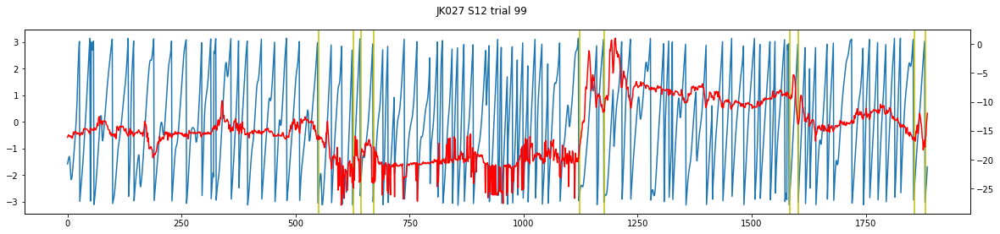

In [146]:
%matplotlib inline
trial_ind = 97
trial_num = whisker_df.index.values[trial_ind]
whisking_start_frames = whisker_df['whiskingStartFrames'].values[trial_ind].astype(int)
fig, ax = plt.subplots(figsize=(20,4))
ax.plot(whisker_df['phase'].values[trial_ind])
for wsf in whisking_start_frames:
    ax.axvline(wsf, color='y')
ax2 = ax.twinx()
ax2.plot(whisker_df['theta'].values[trial_ind], 'r')
fig.suptitle(f'JK{mouse:03d} S{session_num:02d} trial {trial_num}')

In [62]:
whisker_df.protractionTFchunks.values[trial_ind]

[array([607., 608., 609., 610., 611., 612., 613., 614.]),
 array([620., 621., 622., 623., 624.]),
 array([641., 642., 643., 644., 645., 646.]),
 array([653., 654., 655., 656., 657., 658., 659., 660.])]

In [63]:
whisker_df.protractionTFchunksByWhisking.values[trial_ind]

[array([607., 608., 609., 610.]),
 array([641., 642., 643., 644.]),
 array([653., 654., 655., 656., 657., 658., 659.])]

In [122]:
# show the video
mp4_fn = w_dir / f'JK{mouse:03d}S{session_num:02d}' / f'{trial_num}.mp4'
vid_h = imageio.get_reader(mp4_fn, 'ffmpeg')
num_frames = vid_h.count_frames()
frame_size = vid_h.get_meta_data()['size']
vid = np.zeros((num_frames,frame_size[1],frame_size[0]))
for num , im in enumerate(vid_h):
    vid[num] = vid_h.get_data(num)[:,:,0]
napari.view_image(vid);

c:\Users\shires\Anaconda3\envs\suite2p\lib\site-packages\napari\_vispy\vispy_camera.py:109: RuntimeWarning: divide by zero encountered in true_divide
  zoom = np.min(canvas_size / scale)


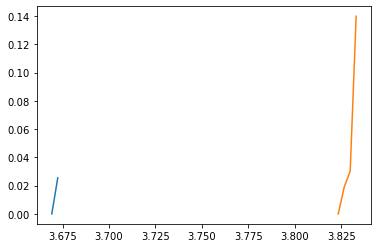

In [147]:
fig, ax = plt.subplots()
for i, tfchunk in enumerate(whisker_df.iloc[trial_ind].protractionTFchunksByWhisking):
    ax.plot(whisker_df.iloc[10].whisker_time[tfchunk.astype(int)-1], whisker_df.iloc[trial_ind].protractionSlideByWhisking[i])

# Adding whisker features

In [3]:
# Merging whisker data to 2p time frames

# Initialization
# touch onset features
kappaH_onset = np.empty(len(frame_time_df))
kappaH_onset[:] = np.nan
kappaV_onset = np.empty(len(frame_time_df))
kappaV_onset[:] = np.nan
phi_onset = np.empty(len(frame_time_df))
phi_onset[:] = np.nan
theta_onset = np.empty(len(frame_time_df))
theta_onset[:] = np.nan
arc_length_onset = np.empty(len(frame_time_df))
arc_length_onset[:] = np.nan
touch_count = np.empty(len(frame_time_df))
touch_count[:] = np.nan
# during touch features
delta_kappaH = np.empty(len(frame_time_df))
delta_kappaH[:] = np.nan
delta_kappaV = np.empty(len(frame_time_df))
delta_kappaV[:] = np.nan
delta_phi = np.empty(len(frame_time_df))
delta_phi[:] = np.nan
delta_theta = np.empty(len(frame_time_df))
delta_theta[:] = np.nan
slide_distance = np.empty(len(frame_time_df))
slide_distance[:] = np.nan
touch_duration = np.empty(len(frame_time_df))
touch_duration[:] = np.nan
# pole frame
pole_up_frame = np.zeros(len(frame_time_df))
pole_moving_frame = np.zeros(len(frame_time_df))

trial_nums = frame_time_df.trialNum.unique()
whisker_empty_trial_nums = []
for trial_num in trial_nums:
    # 2p frame index and time
    trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
    trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index] # end-to-end frame allocation
    # First frame can be quite long, but there is no way that touch happened on the first frame
    # whisker touch time
    trial_whisker_series = whisker_df[whisker_df.index==trial_num]

    if len(trial_whisker_series) == 0: # No whisker processing (or error in the video, etc.)
        whisker_empty_trial_nums.append(trial_num)
    else:
        trial_whisker_time = trial_whisker_series.whisker_time.values[0]

        trial_kappaH = trial_whisker_series.kappaH.values[0]
        trial_kappaV = trial_whisker_series.kappaV.values[0]
        trial_phi = trial_whisker_series.phi.values[0]
        trial_theta = trial_whisker_series.theta.values[0]
        trial_arc_length = trial_whisker_series.arcLength.values[0]

        trial_protraction_touch_chunks = trial_whisker_series.protractionTFchunksByWhisking.values[0] # when touch frame chunks by whisking were used
        # trial_protraction_touch_chunks = trial_whisker_series.protractionTFchunks.values[0] # in case when touch frame chunks were used
        if len(trial_protraction_touch_chunks)>0:
            assert len(trial_protraction_touch_chunks) == len(trial_whisker_series.protractionSlideByWhisking.values[0])
            # touch_onset_times = [trial_whisker_time[touch_chunks[0].astype(int)-1] for touch_chunks in trial_protraction_touch_chunks]
            for touch_ind, touch_chunk_whisker_index in enumerate(trial_protraction_touch_chunks):
                if np.ndim(touch_chunk_whisker_index) == 0:
                    touch_chunk_whisker_index = np.asarray([touch_chunk_whisker_index])
                touch_chunk_whisker_index = touch_chunk_whisker_index.astype(int)-1 # correcting 1-based MATLAB index to 0-based python index
                touch_onset_time = trial_whisker_time[touch_chunk_whisker_index[0]]
                touch_onset_2p_index = np.where(trial_2p_time>touch_onset_time)[0][0]

                # Assign touch onset features
                kappaH_first = trial_kappaH[touch_chunk_whisker_index[0]]
                kappaV_first = trial_kappaV[touch_chunk_whisker_index[0]]
                phi_first = trial_phi[touch_chunk_whisker_index[0]]
                theta_first = trial_theta[touch_chunk_whisker_index[0]]

                if np.isnan(kappaH_onset[trial_2p_index[touch_onset_2p_index]]):
                    kappaH_onset[trial_2p_index[touch_onset_2p_index]] = kappaH_first 
                else:
                    kappaH_onset[trial_2p_index[touch_onset_2p_index]] += kappaH_first 
                if np.isnan(kappaV_onset[trial_2p_index[touch_onset_2p_index]]):
                    kappaV_onset[trial_2p_index[touch_onset_2p_index]] = kappaV_first
                else:
                    kappaV_onset[trial_2p_index[touch_onset_2p_index]] += kappaV_first
                if np.isnan(phi_onset[trial_2p_index[touch_onset_2p_index]]):
                    phi_onset[trial_2p_index[touch_onset_2p_index]] = phi_first
                else:
                    phi_onset[trial_2p_index[touch_onset_2p_index]] += phi_first
                if np.isnan(theta_onset[trial_2p_index[touch_onset_2p_index]]):
                    theta_onset[trial_2p_index[touch_onset_2p_index]] = theta_first
                else:
                    theta_onset[trial_2p_index[touch_onset_2p_index]] += theta_first
                
                if np.isnan(arc_length_onset[trial_2p_index[touch_onset_2p_index]]):
                    arc_length_onset[trial_2p_index[touch_onset_2p_index]] = trial_arc_length[touch_chunk_whisker_index[0]]
                else:
                    arc_length_onset[trial_2p_index[touch_onset_2p_index]] += trial_arc_length[touch_chunk_whisker_index[0]]
                if np.isnan(touch_count[trial_2p_index[touch_onset_2p_index]]):
                    touch_count[trial_2p_index[touch_onset_2p_index]] = 1
                else:
                    touch_count[trial_2p_index[touch_onset_2p_index]] += 1

                # Assign during touch features
                touch_offset_time = trial_whisker_time[touch_chunk_whisker_index[-1]]
                touch_offset_2p_index = np.where(trial_2p_time>touch_offset_time)[0][0]
                slide_distance_trial = trial_whisker_series.protractionSlideByWhisking.values[0][touch_ind]
                if np.ndim(slide_distance_trial) == 0:
                    slide_distance_trial = np.asarray([slide_distance_trial])
                for touch_2p_index in range(touch_onset_2p_index,touch_offset_2p_index+1):
                    # kappaH, kappaV, phi, theta, requires calculating max values within the frame, compared to the first value
                    current_2p_frame_end_time = trial_2p_time[touch_2p_index]
                    if trial_whisker_time[touch_chunk_whisker_index[-1]] > current_2p_frame_end_time: # when the current touch chunk ends later than the current 2p frame end time
                        last_whisker_index_within_frame = np.where(trial_whisker_time[touch_chunk_whisker_index] > current_2p_frame_end_time)[0][0] # excluding this index
                    else:
                        last_whisker_index_within_frame = len(touch_chunk_whisker_index) # excluding this index
                    
                    kappaH_within_frame = trial_kappaH[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                    if np.isnan(delta_kappaH[trial_2p_index[touch_2p_index]]):
                        delta_kappaH[trial_2p_index[touch_2p_index]] = np.amin(kappaH_within_frame - kappaH_first) # For protraction touch, only negative values are allowed
                    else:
                        delta_kappaH[trial_2p_index[touch_2p_index]] += np.amin(kappaH_within_frame - kappaH_first)

                    kappaV_within_frame = trial_kappaV[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                    if np.isnan(delta_kappaV[trial_2p_index[touch_2p_index]]):
                        delta_kappaV[trial_2p_index[touch_2p_index]] = np.amax(np.abs(kappaV_within_frame - kappaV_first)) * np.sign(kappaV_within_frame[np.argmax(np.abs(kappaV_within_frame - kappaV_first))] - kappaV_first)
                    else:
                        delta_kappaV[trial_2p_index[touch_2p_index]] += np.amax(np.abs(kappaV_within_frame - kappaV_first)) * np.sign(kappaV_within_frame[np.argmax(np.abs(kappaV_within_frame - kappaV_first))] - kappaV_first)

                    phi_within_frame = trial_phi[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                    if np.isnan(delta_phi[trial_2p_index[touch_2p_index]]):
                        delta_phi[trial_2p_index[touch_2p_index]] = np.amax(np.abs(phi_within_frame - phi_first)) * np.sign(phi_within_frame[np.argmax(np.abs(phi_within_frame - phi_first))] - phi_first)
                    else:
                        delta_phi[trial_2p_index[touch_2p_index]] += np.amax(np.abs(phi_within_frame - phi_first)) * np.sign(phi_within_frame[np.argmax(np.abs(phi_within_frame - phi_first))] - phi_first)
                    
                    theta_within_frame = trial_theta[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                    if np.isnan(delta_theta[trial_2p_index[touch_2p_index]]):
                        delta_theta[trial_2p_index[touch_2p_index]] = np.amax(theta_within_frame - theta_first) # For protraction touch, only positive values are allowed
                    else:
                        delta_theta[trial_2p_index[touch_2p_index]] += np.amax(theta_within_frame - theta_first)

                    # Slide distance already calculated per whisker time frame, so only requires calculating max values within the frame
                    slide_distance_within_frame = slide_distance_trial[:last_whisker_index_within_frame]
                    if np.isnan(slide_distance[trial_2p_index[touch_2p_index]]):
                        slide_distance[trial_2p_index[touch_2p_index]] = np.amax(slide_distance_within_frame)
                    else:
                        slide_distance[trial_2p_index[touch_2p_index]] += np.amax(slide_distance_within_frame)

                    # Touch duration
                    if np.isnan(touch_duration[trial_2p_index[touch_2p_index]]):
                        touch_duration[trial_2p_index[touch_2p_index]] = trial_whisker_time[touch_chunk_whisker_index[last_whisker_index_within_frame-1]] - touch_onset_time
                    else:
                        touch_duration[trial_2p_index[touch_2p_index]] += trial_whisker_time[touch_chunk_whisker_index[last_whisker_index_within_frame-1]] - touch_onset_time
        
        # Adding pole-up frames and pole-moving frames
        pole_moving_time = trial_whisker_time[trial_whisker_series.poleMovingFrames.values[0].astype(int)-1]
        pole_up_time = trial_whisker_time[trial_whisker_series.poleUpFrames.values[0].astype(int)-1]
        pole_up_2p_frame_first_ind = np.where(trial_2p_time > pole_up_time[0])[0][0]

        if len(np.where(trial_2p_time > pole_up_time[-1])[0]) > 0:
            pole_up_2p_frame_last_ind = np.where(trial_2p_time > pole_up_time[-1])[0][0]
        else:
            pole_up_2p_frame_last_ind = len(trial_2p_time)-1
        pole_up_frame[trial_2p_index[pole_up_2p_frame_first_ind:pole_up_2p_frame_last_ind+1]] = 1

        pole_moving_2p_frame_first_ind = np.where(trial_2p_time > pole_moving_time[0])[0][0]
        pole_moving_frame[trial_2p_index[pole_moving_2p_frame_first_ind:pole_up_2p_frame_first_ind]] = 1

        if pole_moving_time[-1] > pole_up_time[-1]: # only when pole moving happened also after pole up
            if len(np.where(trial_2p_time > pole_moving_time[-1])[0]) > 0:
                pole_moving_2p_frame_last_ind = np.where(trial_2p_time > pole_moving_time[-1])[0][0]
                pole_moving_frame[trial_2p_index[pole_up_2p_frame_last_ind+1:pole_moving_2p_frame_last_ind+1]] = 1

# Adding whisker features to frame time DataFrame
frame_time_df['kappaH_onset'] = kappaH_onset
frame_time_df['kappaV_onset'] = kappaV_onset
frame_time_df['phi_onset'] = phi_onset
frame_time_df['theta_onset'] = theta_onset
frame_time_df['arc_length_onset'] = arc_length_onset
frame_time_df['touch_count'] = touch_count
frame_time_df['delta_kappaH'] = delta_kappaH
frame_time_df['delta_kappaV'] = delta_kappaV
frame_time_df['delta_phi'] = delta_phi
frame_time_df['delta_theta'] = delta_theta
frame_time_df['slide_distance'] = slide_distance
frame_time_df['touch_duration'] = touch_duration

frame_time_df['pole_up_frame'] = pole_up_frame
frame_time_df['pole_moving_frame'] = pole_moving_frame

# Remove frames from trial_num that had error in whisker processing
frame_time_df = frame_time_df[~np.isin(frame_time_df.trialNum.values, np.asarray(whisker_empty_trial_nums))]

In [19]:
temp_df = frame_time_df[frame_time_df.trialNum == 15]
temp_df

,trialNum,frame_start_time,frame_end_time,trial_duration,frame_index,kappaH_onset,kappaV_onset,phi_onset,theta_onset,arc_length_onset,touch_count,delta_kappaH,delta_kappaV,delta_phi,delta_theta,slide_distance,touch_duration,pole_up_frame,pole_moving_frame
563,15,0.115088,0.147517,8.551189,563,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
564,15,0.244806,0.277236,8.551189,564,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
565,15,0.374525,0.406955,8.551189,565,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
566,15,0.504244,0.536674,8.551189,566,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
567,15,0.633963,0.666393,8.551189,567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
568,15,0.763682,0.796112,8.551189,568,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
569,15,0.893401,0.925831,8.551189,569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
570,15,1.023120,1.055550,8.551189,570,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
571,15,1.152839,1.185269,8.551189,571,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0
572,15,1.282558,1.314988,8.551189,572,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0


In [161]:
trial_num

264

In [166]:
trial_whisker_series.keys()

Index(['amplitude', 'arcLength', 'kappaH', 'kappaV', 'midpoint', 'phase',
       'phi', 'poleAngle', 'poleDistance', 'poleMovingFrames', 'polePosition',
       'poleUpFrames', 'protractionSlide', 'protractionSlideByWhisking',
       'protractionTFchunks', 'protractionTFchunksByWhisking',
       'protractionTouchDuration', 'protractionTouchDurationByWhisking',
       'retractionSlide', 'retractionSlideByWhisking', 'retractionTFchunks',
       'retractionTFchunksByWhisking', 'retractionTouchDuration',
       'retractionTouchDurationByWhisking', 'theta', 'whisker_time',
       'whiskingStartFrames', 'mouse_name', 'session_name'],
      dtype='object')

In [180]:
np.set_printoptions(suppress=True)
print(np.round(trial_whisker_series['whisker_time'].values[0], 3))

[0.    0.003 0.006 ... 6.05  6.053 6.056]


In [164]:
trial_2p_time 

array([0.14650385, 0.27622278, 0.40594171, 0.53566065, 0.66537958,
       0.79509851, 0.92481744, 1.05453637, 1.1842553 , 1.31397424,
       1.44369317, 1.5734121 , 1.70313103, 1.83284996, 1.96256889,
       2.09228782, 2.22200676, 2.35172569, 2.48144462, 2.61116355,
       2.74088248, 2.87060141, 3.00032034, 3.13003928, 3.25975821,
       3.38947714, 3.51919607, 3.648915  , 3.77863393, 3.90835287,
       4.0380718 , 4.16779073, 4.29750966, 4.42722859, 4.55694752,
       4.68666645, 4.81638539, 4.94610432, 5.07582325, 5.20554218,
       5.33526111, 5.46498004, 5.59469898, 5.72441791, 5.85413684,
       5.98385577])

In [165]:
pole_up_time

array([1.21449685, 1.21770981, 1.22092276, ..., 5.97930857, 5.98252153,
       5.98573448])

In [181]:
pole_moving_time

array([1.1759414 , 1.17915435, 1.1823673 , 1.18558026, 1.18879321,
       1.19200617, 1.19521912, 1.19843208, 1.20164503, 1.20485799,
       1.20807094, 1.2112839 ])

In [127]:
frame_time_df.keys()

Index(['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration',
       'frame_index', 'kappaH_onset', 'kappaV_onset', 'phi_onset',
       'theta_onset', 'arc_length_onset', 'touch_count', 'delta_kappaH',
       'delta_kappaV', 'delta_phi', 'delta_theta', 'slide_distance',
       'touch_duration', 'pole_up_frame', 'pole_moving_frame'],
      dtype='object')

Text(0.5, 1.0, 'JK025 S01 plane 1')

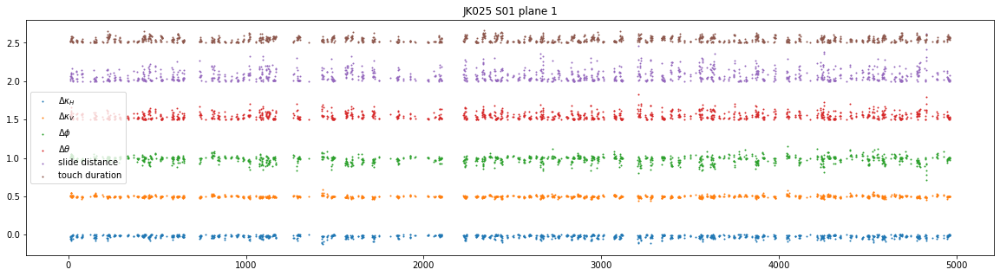

In [132]:
# QC the result
%matplotlib inline
fig, ax = plt.subplots(figsize=(20,5))
ax.scatter(range(len(frame_time_df)), frame_time_df.delta_kappaH, s=1, label=r'$\Delta\kappa_H$')
ax.scatter(range(len(frame_time_df)), frame_time_df.delta_kappaV+0.5*1, s=1, label=r'$\Delta\kappa_V$')
ax.scatter(range(len(frame_time_df)), frame_time_df.delta_phi/100+0.5*2, s=1, label=r'$\Delta\phi$')
ax.scatter(range(len(frame_time_df)), frame_time_df.delta_theta/100+0.5*3, s=1, label=r'$\Delta\theta$')
ax.scatter(range(len(frame_time_df)), frame_time_df.slide_distance/10+0.5*4, s=1, label=r'slide distance')
ax.scatter(range(len(frame_time_df)), frame_time_df.touch_duration+0.5*5, s=1, label=r'touch duration')
ax.legend()
ax.set_title(f'JK{mouse:03d} S{session_num:02d} plane {plane}')


Text(0.5, 1.0, 'JK025 S01 plane 1 trial 50')

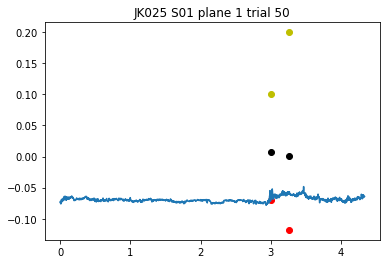

In [134]:
# In single trial, compare between whisker_df and frame_time_df
%matplotlib inline
trial_num = 50
trial_whisker_series = whisker_df[whisker_df.index==trial_num]
trial_whisker_time = trial_whisker_series.whisker_time.values[0]

trial_whisker_kappaH = trial_whisker_series.kappaH.values[0]
trial_whisker_kappaV = trial_whisker_series.kappaV.values[0]
trial_whisker_phi = trial_whisker_series.phi.values[0]
trial_whisker_theta = trial_whisker_series.theta.values[0]
trial_whisker_arc_length = trial_whisker_series.arcLength.values[0]

trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index]

trial_2p_delta_kappaH = frame_time_df.delta_kappaH.values[trial_2p_index]
trial_2p_delta_kappaV = frame_time_df.delta_kappaV.values[trial_2p_index]
trial_2p_delta_theta = frame_time_df.delta_theta.values[trial_2p_index]
trial_2p_delta_phi = frame_time_df.delta_phi.values[trial_2p_index]

trial_2p_kappaH_onset = frame_time_df.kappaH_onset.values[trial_2p_index]
trial_2p_kappaV_onset = frame_time_df.kappaV_onset.values[trial_2p_index]
trial_2p_theta_onset = frame_time_df.theta_onset.values[trial_2p_index]
trial_2p_phi_onset = frame_time_df.phi_onset.values[trial_2p_index]

trial_2p_touch_count = frame_time_df.touch_count.values[trial_2p_index]

fig, ax = plt.subplots()
# ax.plot(trial_whisker_time, trial_whisker_kappaH)
# ax.scatter(trial_2p_time, trial_2p_delta_kappaH, c = 'k')
# ax.scatter(trial_2p_time, trial_2p_kappaH_onset, c = 'r')

ax.plot(trial_whisker_time, trial_whisker_kappaV)
ax.scatter(trial_2p_time, trial_2p_delta_kappaV, c = 'k')
ax.scatter(trial_2p_time, trial_2p_kappaV_onset, c = 'r')

ax.scatter(trial_2p_time, trial_2p_touch_count/10, c = 'y')
ax.set_title(f'JK{mouse:03d} S{session_num:02d} plane {plane} trial {trial_num}')

In [284]:
len(frame_time_df.trialNum.unique())

150

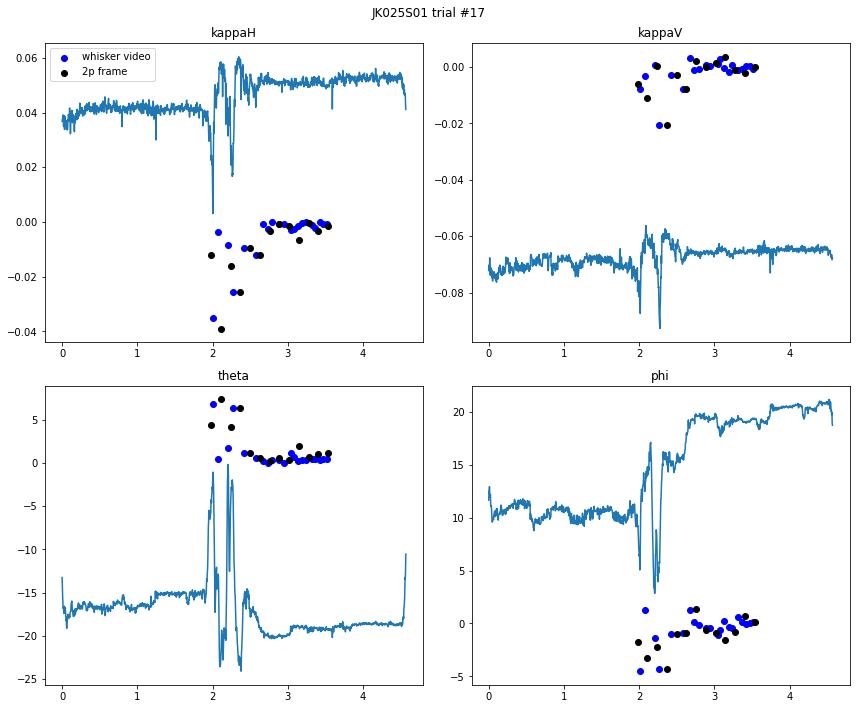

In [472]:
# Compare delta values between those calculated in whisker df and time frame df
trial_num_ind = 15
trial_num = frame_time_df.trialNum.unique()[trial_num_ind]
trial_whisker_series = whisker_df[whisker_df.index==trial_num]
trial_whisker_time = trial_whisker_series.whisker_time.values[0]

trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index]

trial_2p_delta_kappaH = frame_time_df.delta_kappaH.values[trial_2p_index]
trial_2p_delta_kappaV = frame_time_df.delta_kappaV.values[trial_2p_index]
trial_2p_delta_theta = frame_time_df.delta_theta.values[trial_2p_index]
trial_2p_delta_phi = frame_time_df.delta_phi.values[trial_2p_index]

delta_kappaH = []
delta_kappaV = []
delta_theta = []
delta_phi = []
touch_time = []

trial_whisker_kappaH = trial_whisker_series.kappaH.values[0]
trial_whisker_kappaV = trial_whisker_series.kappaV.values[0]
trial_whisker_theta = trial_whisker_series.theta.values[0]
trial_whisker_phi = trial_whisker_series.phi.values[0]
trial_whisker_time = trial_whisker_series.whisker_time.values[0]

for chunk in trial_whisker_series.protractionTFchunksByWhisking.values[0]:
    if np.ndim(chunk)==0:
        chunk = np.array([chunk])
    chunk = chunk.astype(int)-1
    touch_time.append(trial_whisker_time[chunk])

    delta_kappaH.append(np.amin(trial_whisker_kappaH[chunk] - trial_whisker_kappaH[chunk[0]]))
    delta_theta.append(np.amax(trial_whisker_theta[chunk] - trial_whisker_theta[chunk[0]]))
    delta_kappaV_chunk = trial_whisker_kappaV[chunk] - trial_whisker_kappaV[chunk[0]]
    delta_kappaV.append(np.amax(np.abs(delta_kappaV_chunk)) * np.sign(delta_kappaV_chunk[np.argmax(np.abs(delta_kappaV_chunk))]))
    delta_phi_chunk = trial_whisker_phi[chunk] - trial_whisker_phi[chunk[0]]
    delta_phi.append(np.amax(np.abs(delta_phi_chunk)) * np.sign(delta_phi_chunk[np.argmax(np.abs(delta_phi_chunk))]))

fig, ax = plt.subplots(2,2, figsize=(12,10))
ax[0,0].plot(trial_whisker_time, trial_whisker_kappaH)
ax[0,1].plot(trial_whisker_time, trial_whisker_kappaV)
ax[1,0].plot(trial_whisker_time, trial_whisker_theta)
ax[1,1].plot(trial_whisker_time, trial_whisker_phi)
for i, time in enumerate(touch_time):
    if i == 0:
        ax[0,0].scatter(time[-1], delta_kappaH[i], c='b', label='whisker video')
    else:
        ax[0,0].scatter(time[-1], delta_kappaH[i], c='b')
    ax[0,1].scatter(time[-1], delta_kappaV[i], c='b')
    ax[1,0].scatter(time[-1], delta_theta[i], c='b')
    ax[1,1].scatter(time[-1], delta_phi[i], c='b')
ax[0,0].scatter(trial_2p_time, trial_2p_delta_kappaH, c = 'k', label='2p frame')
ax[0,1].scatter(trial_2p_time, trial_2p_delta_kappaV, c = 'k')
ax[1,0].scatter(trial_2p_time, trial_2p_delta_theta, c = 'k')
ax[1,1].scatter(trial_2p_time, trial_2p_delta_phi, c = 'k')

ax[0,0].legend()

ax[0,0].set_title('kappaH')
ax[0,1].set_title('kappaV')
ax[1,0].set_title('theta')
ax[1,1].set_title('phi')
fig.suptitle(f'JK{mouse:03d}S{session_num:02d} trial #{trial_num}')
fig.tight_layout()

# Adding behavior parameters

- Behavior
- (pole_up_frame and pole_moving_frame from whisker df)
    - Pole angle
    - Pole AP distance and lateral distance (lateral should have been fixed except for distractor sessions)
    - First lick frame (bool)
    - First lick choice (left or right)
    - Number of left licks (per frame)
    - Number of right licks (per frame)
    - Answer lick frame (bool)
    - Answer lick choice (left or right)
    - Pre-answer pole-up frame (bool)
    - Answer period frame (bool)
    - Post-answer frame (bool)
    - First reward lick frame (bool)
    - Hit (bool)
    - Miss (bool)
    - Wrong (bool)
- Blank values:
    - answerLickTime: [0,0]
    - beamBreakTimesLeft: [0,1]
    - beamBreakTimesRight: [0,1]
    - drinkingTime: [0,0]
    - rewardTimeLeft: [0,0]
    - rewardTimeRight: [0,0]

In [10]:
# Initialize
pole_angle = np.zeros(len(frame_time_df), dtype=np.uint16)
pole_ap_distance = np.zeros(len(frame_time_df), dtype=np.uint32)
pole_radial_distance = np.zeros(len(frame_time_df), dtype=np.uint32)
# It should be first choice lick, first of the licks that precede the answer lick at the same side
# first_lick_frame = np.zeros(len(frame_time_df), dtype=bool)
# first_lick_left = np.zeros(len(frame_time_df), dtype=bool) # if first lick is right, then 0
# first_lick_right = np.zeros(len(frame_time_df), dtype=bool) # if first lick is left, then 0
num_lick_left = np.zeros(len(frame_time_df), dtype=np.uint8)
num_lick_right = np.zeros(len(frame_time_df), dtype=np.uint8)
answer_lick_frame = np.zeros(len(frame_time_df), dtype=bool)
answer_lick_left = np.zeros(len(frame_time_df), dtype=bool) # if answer lick is right, then 0
answer_lick_right = np.zeros(len(frame_time_df), dtype=bool) # if answer lick is left, then 0
pre_answer_pole_up_frame = np.zeros(len(frame_time_df), dtype=bool)
answer_period_frame = np.zeros(len(frame_time_df), dtype=bool)
post_answer_pole_up_frame = np.zeros(len(frame_time_df), dtype=bool)
first_reward_lick_frame = np.zeros(len(frame_time_df), dtype=bool)
first_reward_lick_left = np.zeros(len(frame_time_df), dtype=bool) # if first reward lick is right, then 0
first_reward_lick_right = np.zeros(len(frame_time_df), dtype=bool) # if first reward lick is left, then 0
correct = np.zeros(len(frame_time_df), dtype=bool)
wrong = np.zeros(len(frame_time_df), dtype=bool)
miss = np.zeros(len(frame_time_df), dtype=bool)
trial_type = []
task_target = []
distractor = []

trial_nums = frame_time_df.trialNum.unique()
for trial_num in trial_nums:
    # 2p frame index and time
    trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
    trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index] # end-to-end frame allocation

    assert sum(behavior_df.index == trial_num)==1
    trial_behavior_series = behavior_df[behavior_df.index==trial_num].iloc[0]
    pole_angle[trial_2p_index] = trial_behavior_series.servoAngle
    pole_ap_distance[trial_2p_index] = trial_behavior_series.motorApPosition
    pole_radial_distance[trial_2p_index] = trial_behavior_series.motorDistance
    trial_type.extend([trial_behavior_series.trialType]*len(trial_2p_index))
    task_target.extend([trial_behavior_series.task_target]*len(trial_2p_index))
    distractor.extend([trial_behavior_series.distractor]*len(trial_2p_index))

    lick_times = np.empty(0,)
    left_lick_times = trial_behavior_series.beamBreakTimesLeft
    if np.size(left_lick_times)==1:
        left_lick_times = np.array([left_lick_times])    
    right_lick_times = trial_behavior_series.beamBreakTimesRight
    if np.size(right_lick_times)==1:
        right_lick_times = np.array([right_lick_times])
    answer_lick_time = trial_behavior_series.answerLickTime
    if answer_lick_time != 0: # answer trial
        if (answer_lick_time not in left_lick_times) and (answer_lick_time not in right_lick_times): # In some rare cases
            if trial_behavior_series.choice == 'r':
                right_lick_times = np.union1d(answer_lick_time, right_lick_times)
            elif trial_behavior_series.choice == 'l':
                left_lick_times = np.union1d(answer_lick_time, left_lick_times)
            else:
                raise('When the answer lick time is not 0, there must have been either r or l choice.')

    if not ((np.size(left_lick_times)==1) and (np.array(left_lick_times==[0]))):
        lick_times = np.hstack((lick_times,left_lick_times))
        for left_lick_time in left_lick_times:
            if left_lick_time < trial_2p_time[-1]:
                left_lick_frame_ind = np.where(trial_2p_time > left_lick_time)[0][0]
                num_lick_left[trial_2p_index[left_lick_frame_ind]] += 1

    if not ((np.size(right_lick_times)==1) and (np.array(right_lick_times==[0]))):
        lick_times = np.hstack((lick_times,right_lick_times))
        for right_lick_time in right_lick_times:
            if right_lick_time < trial_2p_time[-1]:
                right_lick_frame_ind = np.where(trial_2p_time > right_lick_time)[0][0]
                num_lick_right[trial_2p_index[right_lick_frame_ind]] += 1

    # if len(lick_times) > 0:
    #     first_lick_time = np.amin(lick_times)
    #     if first_lick_time < trial_2p_time[-1]:
    #         first_lick_ind = np.where(trial_2p_time > first_lick_time)[0][0]
    #         first_lick_frame[trial_2p_index[first_lick_ind]] = 1
    #         if first_lick_time in left_lick_times:
    #             first_lick_left[trial_2p_index[first_lick_ind]] = 1
    #         elif first_lick_time in right_lick_times:
    #             first_lick_right[trial_2p_index[first_lick_ind]] = 1
    #         else:
    #             raise('First lick should be in either left or right beam break times')
    
    answer_lick_time = trial_behavior_series.answerLickTime
    if answer_lick_time != 0: # answer trial
        answer_lick_frame_ind = np.where(trial_2p_time > answer_lick_time)[0][0]
        answer_lick_frame[trial_2p_index[answer_lick_frame_ind]] = 1
        if answer_lick_time in left_lick_times:
            answer_lick_left[trial_2p_index[answer_lick_frame_ind]] = 1
        elif answer_lick_time in right_lick_times:
            answer_lick_right[trial_2p_index[answer_lick_frame_ind]] = 1
        else:
            raise('Answer lick assignment should have been corrected.')
        
        if not np.array(trial_behavior_series.drinkingTime==[0,0]).all(): # correct trial
            correct[trial_2p_index] = 1
            if answer_lick_time in left_lick_times: # left trial
                if left_lick_times[-1] > answer_lick_time: # else, the reward was not taken during the trial
                    first_reward_lick_time = left_lick_times[np.where(left_lick_times > answer_lick_time)[0][0]]
                    if trial_2p_time[-1] > first_reward_lick_time: # else, the reward was not taken during 2p imaging for the trial
                        first_reward_lick_frame_ind = np.where(trial_2p_time > first_reward_lick_time)[0][0]
                        first_reward_lick_frame[trial_2p_index[first_reward_lick_frame_ind]] = 1
                        first_reward_lick_left[trial_2p_index[first_reward_lick_frame_ind]] = 1
            else: # right trial. Exception error dealt above
                if right_lick_times[-1] > answer_lick_time: # else, the reward was not taken during the trial
                    first_reward_lick_time = right_lick_times[np.where(right_lick_times > answer_lick_time)[0][0]]
                    if trial_2p_time[-1] > first_reward_lick_time: # else, the reward was not taken during 2p imaging for the trial
                        first_reward_lick_frame_ind = np.where(trial_2p_time > first_reward_lick_time)[0][0]
                        first_reward_lick_frame[trial_2p_index[first_reward_lick_frame_ind]] = 1
                        first_reward_lick_right[trial_2p_index[first_reward_lick_frame_ind]] = 1
        else:
            wrong[trial_2p_index] = 1
        
        trial_pole_up_frame = frame_time_df.pole_up_frame.values[trial_2p_index]
        trial_pre_answer_frame = np.zeros(len(trial_pole_up_frame), dtype=bool)
        trial_pre_answer_frame[:answer_lick_frame_ind] = 1
        pre_answer_pole_up_frame[trial_2p_index] = trial_pole_up_frame * trial_pre_answer_frame
        trial_post_answer_frame = np.zeros(len(trial_pole_up_frame), dtype=bool)
        trial_post_answer_frame[answer_lick_frame_ind+1:] = 1
        post_answer_pole_up_frame[trial_2p_index] = trial_pole_up_frame * trial_post_answer_frame
        
    else:
        miss[trial_2p_index] = 1

    answer_period_time = trial_behavior_series.answerPeriodTime
    answer_period_frame_first_ind = np.where(trial_2p_time > answer_period_time[0])[0][0]
    answer_period_frame_last_ind = np.where(trial_2p_time > answer_period_time[1])[0][0]
    answer_period_frame[trial_2p_index[answer_period_frame_first_ind:answer_period_frame_last_ind+1]] = 1

# Adding to the DataFrame
frame_time_df['pole_angle'] = pole_angle
frame_time_df['pole_ap_distance'] = pole_ap_distance
frame_time_df['pole_radial_distance'] = pole_radial_distance
# frame_time_df['first_lick_frame'] = first_lick_frame
# frame_time_df['first_lick_left'] = first_lick_left
# frame_time_df['first_lick_right'] = first_lick_right
frame_time_df['num_lick_left'] = num_lick_left
frame_time_df['num_lick_right'] = num_lick_right
frame_time_df['answer_lick_frame'] = answer_lick_frame
frame_time_df['answer_lick_left'] = answer_lick_left
frame_time_df['answer_lick_right'] = answer_lick_right
frame_time_df['pre_answer_pole_up_frame'] = pre_answer_pole_up_frame
frame_time_df['answer_period_frame'] = answer_period_frame
frame_time_df['post_answer_pole_up_frame'] = post_answer_pole_up_frame
frame_time_df['first_reward_lick_frame'] = first_reward_lick_frame
frame_time_df['first_reward_lick_left'] = first_reward_lick_left
frame_time_df['first_reward_lick_right'] = first_reward_lick_right
frame_time_df['correct'] = correct
frame_time_df['wrong'] = wrong
frame_time_df['miss'] = miss
frame_time_df['trial_type'] = trial_type
frame_time_df['task_target'] = task_target
frame_time_df['distractor'] = distractor

# Additional information
frame_time_df['mouse_name'] = behavior_df.iloc[0].mouse_name
frame_time_df['session_name'] = behavior_df.iloc[0].session_name
frame_time_df['session_type'] = behavior_df.iloc[0].session_type

In [136]:
# QC
np.unique(frame_time_df.miss.values.astype(int) + frame_time_df.correct.values.astype(int) + frame_time_df.wrong.values.astype(int))
# Must be [1]

array([1])

Text(0.5, 1.0, 'JK025 S01 plane 1 trial 12')

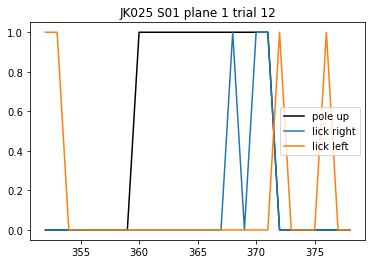

In [140]:
# QC
trial_ind = 10
trial_num = frame_time_df.trialNum.unique()[trial_ind]
trial_df = frame_time_df[frame_time_df.trialNum == trial_num]
fig, ax = plt.subplots()
ax.plot(trial_df.pole_up_frame, 'k', label='pole up')
ax.plot(trial_df.num_lick_right, label='lick right')
ax.plot(trial_df.num_lick_left, label='lick left')
ax.legend()
ax.set_title(f'JK{mouse:03d} S{session_num:02d} plane {plane} trial {trial_num}')

In [375]:
np.unique(frame_time_df.miss.values.astype(int) + frame_time_df.correct.values.astype(int) + frame_time_df.wrong.values.astype(int))

array([1])

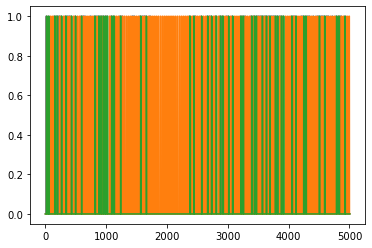

In [141]:
%matplotlib inline
fig, ax = plt.subplots()
ax.plot(frame_time_df.pre_answer_pole_up_frame)
ax.plot(frame_time_df.answer_period_frame)
ax.plot(frame_time_df.post_answer_pole_up_frame)

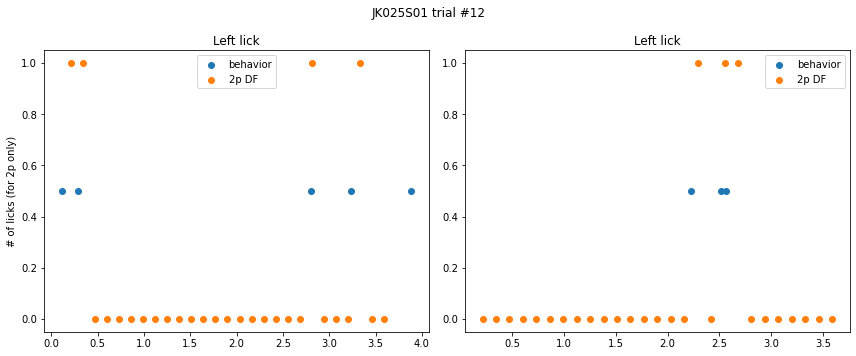

In [509]:
# QC by comparing the behavior result and frame_time_df result
# (1) licks
trial_ind = 10
trial_num = frame_time_df.trialNum.unique()[trial_ind]

behavior_trial_series = behavior_df[behavior_df.index==trial_num].iloc[0]
frame_time_df_trial = frame_time_df[frame_time_df.trialNum==trial_num]

left_lick_times = behavior_trial_series.beamBreakTimesLeft
if np.size(left_lick_times)==1:
    left_lick_times = np.array([left_lick_times])    
right_lick_times = behavior_trial_series.beamBreakTimesRight
if np.size(right_lick_times)==1:
    right_lick_times = np.array([right_lick_times])
answer_lick_time = behavior_trial_series.answerLickTime
if answer_lick_time != 0: # answer trial
    if (answer_lick_time not in left_lick_times) and (answer_lick_time not in right_lick_times): # In some rare cases
        if behavior_trial_series.choice == 'r':
            right_lick_times = np.union1d(answer_lick_time, right_lick_times)
        elif behavior_trial_series.choice == 'l':
            left_lick_times = np.union1d(answer_lick_time, left_lick_times)
        else:
            raise('When the answer lick time is not 0, there must have been either r or l choice.')

%matplotlib inline
fig, ax = plt.subplots(1,2, figsize=(12,5))
ax[0].scatter(left_lick_times, np.ones(len(left_lick_times))*0.5, label='behavior')
ax[0].scatter(frame_time_df_trial.frame_end_time.values, frame_time_df_trial.num_lick_left.values, label='2p DF')
ax[0].set_ylabel('# of licks (for 2p only)')
ax[0].legend()
ax[0].set_title('Left lick')
ax[1].scatter(right_lick_times, np.ones(len(right_lick_times))*0.5, label='behavior')
ax[1].scatter(frame_time_df_trial.frame_end_time.values, frame_time_df_trial.num_lick_right.values, label='2p DF')
ax[1].legend()
ax[1].set_title('Left lick')
fig.suptitle(f'JK{mouse:03d}S{session_num:02d} trial #{trial_num}')
fig.tight_layout()


In [504]:
left_lick_times

array([0.111484, 0.285317, 2.80264 , 3.231971, 3.885469])

In [497]:
frame_time_df_trial = frame_time_df[frame_time_df.trialNum==trial_num]
frame_time_df_trial.keys()

Index(['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration',
       'kappaH_onset', 'kappaV_onset', 'phi_onset', 'theta_onset',
       'arc_length_onset', 'touch_count', 'delta_kappaH', 'delta_kappaV',
       'delta_phi', 'delta_theta', 'slide_distance', 'touch_duration',
       'pole_up_frame', 'pole_moving_frame', 'pole_angle', 'pole_ap_distance',
       'pole_radial_distance', 'first_lick_frame', 'first_lick_left',
       'first_lick_right', 'num_lick_left', 'num_lick_right',
       'answer_lick_frame', 'answer_lick_left', 'answer_lick_right',
       'pre_answer_pole_up_frame', 'answer_period_frame',
       'post_answer_pole_up_frame', 'first_reward_lick_frame',
       'first_reward_lick_left', 'first_reward_lick_right', 'correct', 'wrong',
       'miss'],
      dtype='object')

In [345]:
trial_behavior_series.beamBreakTimesLeft.values[0]

array([1.099647, 1.351146, 2.357309, 2.621974, 2.741974, 3.056973,
       3.403987, 3.516971, 3.694819, 3.892636, 5.085798, 5.291964,
       5.769795, 5.894295, 6.069294, 6.237309, 6.422626])

# Run all mice
- 3 mice for now (JK025, 027, 030; 2023/01/02)

In [192]:
def merge_whisker_to_frame_df(frame_time_df, whisker_df):
    # Initialization
    # touch onset features
    kappaH_onset = np.empty(len(frame_time_df))
    kappaH_onset[:] = np.nan
    kappaV_onset = np.empty(len(frame_time_df))
    kappaV_onset[:] = np.nan
    phi_onset = np.empty(len(frame_time_df))
    phi_onset[:] = np.nan
    theta_onset = np.empty(len(frame_time_df))
    theta_onset[:] = np.nan
    arc_length_onset = np.empty(len(frame_time_df))
    arc_length_onset[:] = np.nan
    touch_count = np.empty(len(frame_time_df))
    touch_count[:] = np.nan
    # during touch features
    delta_kappaH = np.empty(len(frame_time_df))
    delta_kappaH[:] = np.nan
    delta_kappaV = np.empty(len(frame_time_df))
    delta_kappaV[:] = np.nan
    delta_phi = np.empty(len(frame_time_df))
    delta_phi[:] = np.nan
    delta_theta = np.empty(len(frame_time_df))
    delta_theta[:] = np.nan
    slide_distance = np.empty(len(frame_time_df))
    slide_distance[:] = np.nan
    touch_duration = np.empty(len(frame_time_df))
    touch_duration[:] = np.nan
    # pole frame
    pole_up_frame = np.zeros(len(frame_time_df))
    pole_moving_frame = np.zeros(len(frame_time_df))

    trial_nums = frame_time_df.trialNum.unique()
    whisker_empty_trial_nums = []
    for trial_num in trial_nums:
        # 2p frame index and time
        trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
        trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index] # end-to-end frame allocation
        # First frame can be quite long, but there is no way that touch happened on the first frame
        # whisker touch time
        trial_whisker_series = whisker_df[whisker_df.index==trial_num]

        if len(trial_whisker_series) == 0: # No whisker processing (or error in the video, etc.)
            whisker_empty_trial_nums.append(trial_num)
        else:
            trial_whisker_time = trial_whisker_series.whisker_time.values[0]

            trial_kappaH = trial_whisker_series.kappaH.values[0]
            trial_kappaV = trial_whisker_series.kappaV.values[0]
            trial_phi = trial_whisker_series.phi.values[0]
            trial_theta = trial_whisker_series.theta.values[0]
            trial_arc_length = trial_whisker_series.arcLength.values[0]

            if trial_whisker_series.trialType.values[0] != 'oo':  # 'oo' denotes out of reach pole up trials. No touch happened, and no pole up could be detected from the video reliably.

                trial_protraction_touch_chunks = trial_whisker_series.protractionTFchunksByWhisking.values[0] # when touch frame chunks by whisking were used
                # trial_protraction_touch_chunks = trial_whisker_series.protractionTFchunks.values[0] # in case when touch frame chunks were used
                if len(trial_protraction_touch_chunks)>0:
                    assert len(trial_protraction_touch_chunks) == len(trial_whisker_series.protractionSlideByWhisking.values[0])
                    # touch_onset_times = [trial_whisker_time[touch_chunks[0].astype(int)-1] for touch_chunks in trial_protraction_touch_chunks]
                    for touch_ind, touch_chunk_whisker_index in enumerate(trial_protraction_touch_chunks):
                        if np.ndim(touch_chunk_whisker_index) == 0:
                            touch_chunk_whisker_index = np.asarray([touch_chunk_whisker_index])
                        touch_chunk_whisker_index = touch_chunk_whisker_index.astype(int)-1 # correcting 1-based MATLAB index to 0-based python index
                        touch_onset_time = trial_whisker_time[touch_chunk_whisker_index[0]]
                        touch_onset_2p_index = np.where(trial_2p_time>touch_onset_time)[0][0]

                        # Assign touch onset features
                        kappaH_first = trial_kappaH[touch_chunk_whisker_index[0]]
                        kappaV_first = trial_kappaV[touch_chunk_whisker_index[0]]
                        phi_first = trial_phi[touch_chunk_whisker_index[0]]
                        theta_first = trial_theta[touch_chunk_whisker_index[0]]

                        if np.isnan(kappaH_onset[trial_2p_index[touch_onset_2p_index]]):
                            kappaH_onset[trial_2p_index[touch_onset_2p_index]] = kappaH_first 
                        else:
                            kappaH_onset[trial_2p_index[touch_onset_2p_index]] += kappaH_first 
                        if np.isnan(kappaV_onset[trial_2p_index[touch_onset_2p_index]]):
                            kappaV_onset[trial_2p_index[touch_onset_2p_index]] = kappaV_first
                        else:
                            kappaV_onset[trial_2p_index[touch_onset_2p_index]] += kappaV_first
                        if np.isnan(phi_onset[trial_2p_index[touch_onset_2p_index]]):
                            phi_onset[trial_2p_index[touch_onset_2p_index]] = phi_first
                        else:
                            phi_onset[trial_2p_index[touch_onset_2p_index]] += phi_first
                        if np.isnan(theta_onset[trial_2p_index[touch_onset_2p_index]]):
                            theta_onset[trial_2p_index[touch_onset_2p_index]] = theta_first
                        else:
                            theta_onset[trial_2p_index[touch_onset_2p_index]] += theta_first
                        
                        if np.isnan(arc_length_onset[trial_2p_index[touch_onset_2p_index]]):
                            arc_length_onset[trial_2p_index[touch_onset_2p_index]] = trial_arc_length[touch_chunk_whisker_index[0]]
                        else:
                            arc_length_onset[trial_2p_index[touch_onset_2p_index]] += trial_arc_length[touch_chunk_whisker_index[0]]
                        if np.isnan(touch_count[trial_2p_index[touch_onset_2p_index]]):
                            touch_count[trial_2p_index[touch_onset_2p_index]] = 1
                        else:
                            touch_count[trial_2p_index[touch_onset_2p_index]] += 1

                        # Assign during touch features
                        touch_offset_time = trial_whisker_time[touch_chunk_whisker_index[-1]]
                        touch_offset_2p_index = np.where(trial_2p_time>touch_offset_time)[0][0]
                        slide_distance_trial = trial_whisker_series.protractionSlideByWhisking.values[0][touch_ind]
                        if np.ndim(slide_distance_trial) == 0:
                            slide_distance_trial = np.asarray([slide_distance_trial])
                        for touch_2p_index in range(touch_onset_2p_index,touch_offset_2p_index+1):
                            # kappaH, kappaV, phi, theta, requires calculating max values within the frame, compared to the first value
                            current_2p_frame_end_time = trial_2p_time[touch_2p_index]
                            if trial_whisker_time[touch_chunk_whisker_index[-1]] > current_2p_frame_end_time: # when the current touch chunk ends later than the current 2p frame end time
                                last_whisker_index_within_frame = np.where(trial_whisker_time[touch_chunk_whisker_index] > current_2p_frame_end_time)[0][0] # excluding this index
                            else:
                                last_whisker_index_within_frame = len(touch_chunk_whisker_index) # excluding this index
                            
                            kappaH_within_frame = trial_kappaH[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                            if np.isnan(delta_kappaH[trial_2p_index[touch_2p_index]]):
                                delta_kappaH[trial_2p_index[touch_2p_index]] = np.amin(kappaH_within_frame - kappaH_first) # For protraction touch, only negative values are allowed
                            else:
                                delta_kappaH[trial_2p_index[touch_2p_index]] += np.amin(kappaH_within_frame - kappaH_first)

                            kappaV_within_frame = trial_kappaV[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                            if np.isnan(delta_kappaV[trial_2p_index[touch_2p_index]]):
                                delta_kappaV[trial_2p_index[touch_2p_index]] = np.amax(np.abs(kappaV_within_frame - kappaV_first)) * np.sign(kappaV_within_frame[np.argmax(np.abs(kappaV_within_frame - kappaV_first))] - kappaV_first)
                            else:
                                delta_kappaV[trial_2p_index[touch_2p_index]] += np.amax(np.abs(kappaV_within_frame - kappaV_first)) * np.sign(kappaV_within_frame[np.argmax(np.abs(kappaV_within_frame - kappaV_first))] - kappaV_first)

                            phi_within_frame = trial_phi[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                            if np.isnan(delta_phi[trial_2p_index[touch_2p_index]]):
                                delta_phi[trial_2p_index[touch_2p_index]] = np.amax(np.abs(phi_within_frame - phi_first)) * np.sign(phi_within_frame[np.argmax(np.abs(phi_within_frame - phi_first))] - phi_first)
                            else:
                                delta_phi[trial_2p_index[touch_2p_index]] += np.amax(np.abs(phi_within_frame - phi_first)) * np.sign(phi_within_frame[np.argmax(np.abs(phi_within_frame - phi_first))] - phi_first)
                            
                            theta_within_frame = trial_theta[touch_chunk_whisker_index[:last_whisker_index_within_frame]]
                            if np.isnan(delta_theta[trial_2p_index[touch_2p_index]]):
                                delta_theta[trial_2p_index[touch_2p_index]] = np.amax(theta_within_frame - theta_first) # For protraction touch, only positive values are allowed
                            else:
                                delta_theta[trial_2p_index[touch_2p_index]] += np.amax(theta_within_frame - theta_first)

                            # Slide distance already calculated per whisker time frame, so only requires calculating max values within the frame
                            slide_distance_within_frame = slide_distance_trial[:last_whisker_index_within_frame]
                            if np.isnan(slide_distance[trial_2p_index[touch_2p_index]]):
                                slide_distance[trial_2p_index[touch_2p_index]] = np.amax(slide_distance_within_frame)
                            else:
                                slide_distance[trial_2p_index[touch_2p_index]] += np.amax(slide_distance_within_frame)

                            # Touch duration
                            if np.isnan(touch_duration[trial_2p_index[touch_2p_index]]):
                                touch_duration[trial_2p_index[touch_2p_index]] = trial_whisker_time[touch_chunk_whisker_index[last_whisker_index_within_frame-1]] - touch_onset_time
                            else:
                                touch_duration[trial_2p_index[touch_2p_index]] += trial_whisker_time[touch_chunk_whisker_index[last_whisker_index_within_frame-1]] - touch_onset_time
                
                # Adding pole-up frames and pole-moving frames
                pole_moving_time = trial_whisker_time[trial_whisker_series.poleMovingFrames.values[0].astype(int)-1]
                pole_up_time = trial_whisker_time[trial_whisker_series.poleUpFrames.values[0].astype(int)-1]
                pole_up_2p_frame_first_ind = np.where(trial_2p_time > pole_up_time[0])[0][0]

                if len(np.where(trial_2p_time > pole_up_time[-1])[0]) > 0:
                    pole_up_2p_frame_last_ind = np.where(trial_2p_time > pole_up_time[-1])[0][0]
                else:
                    pole_up_2p_frame_last_ind = len(trial_2p_time)-1
                pole_up_frame[trial_2p_index[pole_up_2p_frame_first_ind:pole_up_2p_frame_last_ind+1]] = 1

                pole_moving_2p_frame_first_ind = np.where(trial_2p_time > pole_moving_time[0])[0][0]
                pole_moving_frame[trial_2p_index[pole_moving_2p_frame_first_ind:pole_up_2p_frame_first_ind]] = 1

                if pole_moving_time[-1] > pole_up_time[-1]: # only when pole moving happened also after pole up
                    if len(np.where(trial_2p_time > pole_moving_time[-1])[0]) > 0:
                        pole_moving_2p_frame_last_ind = np.where(trial_2p_time > pole_moving_time[-1])[0][0]
                        pole_moving_frame[trial_2p_index[pole_up_2p_frame_last_ind+1:pole_moving_2p_frame_last_ind+1]] = 1

    # Adding whisker features to frame time DataFrame
    frame_time_df['kappaH_onset'] = kappaH_onset
    frame_time_df['kappaV_onset'] = kappaV_onset
    frame_time_df['phi_onset'] = phi_onset
    frame_time_df['theta_onset'] = theta_onset
    frame_time_df['arc_length_onset'] = arc_length_onset
    frame_time_df['touch_count'] = touch_count
    frame_time_df['delta_kappaH'] = delta_kappaH
    frame_time_df['delta_kappaV'] = delta_kappaV
    frame_time_df['delta_phi'] = delta_phi
    frame_time_df['delta_theta'] = delta_theta
    frame_time_df['slide_distance'] = slide_distance
    frame_time_df['touch_duration'] = touch_duration

    frame_time_df['pole_up_frame'] = pole_up_frame
    frame_time_df['pole_moving_frame'] = pole_moving_frame

    # Remove frames from trial_num that had error in whisker processing
    frame_time_df = frame_time_df[~np.isin(frame_time_df.trialNum.values, np.asarray(whisker_empty_trial_nums))]

    return frame_time_df

In [238]:
def merge_behavior_to_frame_df(frame_time_df, behavior_df):

    # remove error trials
    # happens in catch trials where answer lick time does not match with either right or left lick times
    # can't correct the answer lick time in this case, so just remove them.
    # Happens rarely
    trial_nums = frame_time_df.trialNum.unique()
    error_trial_nums = behavior_df[behavior_df.choice=='e'].index.values
    trial_nums = np.setdiff1d(trial_nums, error_trial_nums)
    frame_time_df = frame_time_df[np.isin(frame_time_df.trialNum.values, trial_nums)]
    behavior_df = behavior_df[np.isin(behavior_df.index.values, trial_nums)]

    # Initialize
    pole_angle = np.zeros(len(frame_time_df), dtype=np.uint16)
    pole_ap_distance = np.zeros(len(frame_time_df), dtype=np.uint32)
    pole_radial_distance = np.zeros(len(frame_time_df), dtype=np.uint32)
    # It should be first choice lick, first of the licks that precede the answer lick at the same side
    # first_lick_frame = np.zeros(len(frame_time_df), dtype=bool)
    # first_lick_left = np.zeros(len(frame_time_df), dtype=bool) # if first lick is right, then 0
    # first_lick_right = np.zeros(len(frame_time_df), dtype=bool) # if first lick is left, then 0
    num_lick_left = np.zeros(len(frame_time_df), dtype=np.uint8)
    num_lick_right = np.zeros(len(frame_time_df), dtype=np.uint8)
    answer_lick_frame = np.zeros(len(frame_time_df), dtype=bool)
    answer_lick_left = np.zeros(len(frame_time_df), dtype=bool) # if answer lick is right, then 0
    answer_lick_right = np.zeros(len(frame_time_df), dtype=bool) # if answer lick is left, then 0
    pre_answer_pole_up_frame = np.zeros(len(frame_time_df), dtype=bool)
    answer_period_frame = np.zeros(len(frame_time_df), dtype=bool)
    post_answer_pole_up_frame = np.zeros(len(frame_time_df), dtype=bool)
    first_reward_lick_frame = np.zeros(len(frame_time_df), dtype=bool)
    first_reward_lick_left = np.zeros(len(frame_time_df), dtype=bool) # if first reward lick is right, then 0
    first_reward_lick_right = np.zeros(len(frame_time_df), dtype=bool) # if first reward lick is left, then 0
    correct = np.zeros(len(frame_time_df), dtype=bool)
    wrong = np.zeros(len(frame_time_df), dtype=bool)
    miss = np.zeros(len(frame_time_df), dtype=bool)
    trial_type = []
    task_target = []
    distractor = []

    for trial_num in trial_nums:
        # 2p frame index and time
        trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
        trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index] # end-to-end frame allocation

        assert sum(behavior_df.index == trial_num)==1
        trial_behavior_series = behavior_df[behavior_df.index==trial_num].iloc[0]
        pole_angle[trial_2p_index] = trial_behavior_series.servoAngle
        pole_ap_distance[trial_2p_index] = trial_behavior_series.motorApPosition
        pole_radial_distance[trial_2p_index] = trial_behavior_series.motorDistance
        trial_type.extend([trial_behavior_series.trialType]*len(trial_2p_index))
        task_target.extend([trial_behavior_series.task_target]*len(trial_2p_index))
        distractor.extend([trial_behavior_series.distractor]*len(trial_2p_index))

        lick_times = np.empty(0,)
        left_lick_times = trial_behavior_series.beamBreakTimesLeft
        if np.size(left_lick_times)==1:
            left_lick_times = np.array([left_lick_times])    
        right_lick_times = trial_behavior_series.beamBreakTimesRight
        if np.size(right_lick_times)==1:
            right_lick_times = np.array([right_lick_times])
        answer_lick_time = trial_behavior_series.answerLickTime
        if answer_lick_time != 0: # answer trial
            if (answer_lick_time not in left_lick_times) and (answer_lick_time not in right_lick_times): # In some rare cases
                if trial_behavior_series.choice == 'r':
                    right_lick_times = np.union1d(answer_lick_time, right_lick_times)
                elif trial_behavior_series.choice == 'l':
                    left_lick_times = np.union1d(answer_lick_time, left_lick_times)
                else:
                    raise('When the answer lick time is not 0, there must have been either r or l choice.')

        if not ((np.size(left_lick_times)==1) and (np.array(left_lick_times==[0]))):
            lick_times = np.hstack((lick_times,left_lick_times))
            for left_lick_time in left_lick_times:
                if left_lick_time < trial_2p_time[-1]:
                    left_lick_frame_ind = np.where(trial_2p_time > left_lick_time)[0][0]
                    num_lick_left[trial_2p_index[left_lick_frame_ind]] += 1

        if not ((np.size(right_lick_times)==1) and (np.array(right_lick_times==[0]))):
            lick_times = np.hstack((lick_times,right_lick_times))
            for right_lick_time in right_lick_times:
                if right_lick_time < trial_2p_time[-1]:
                    right_lick_frame_ind = np.where(trial_2p_time > right_lick_time)[0][0]
                    num_lick_right[trial_2p_index[right_lick_frame_ind]] += 1

        # if len(lick_times) > 0:
        #     first_lick_time = np.amin(lick_times)
        #     if first_lick_time < trial_2p_time[-1]:
        #         first_lick_ind = np.where(trial_2p_time > first_lick_time)[0][0]
        #         first_lick_frame[trial_2p_index[first_lick_ind]] = 1
        #         if first_lick_time in left_lick_times:
        #             first_lick_left[trial_2p_index[first_lick_ind]] = 1
        #         elif first_lick_time in right_lick_times:
        #             first_lick_right[trial_2p_index[first_lick_ind]] = 1
        #         else:
        #             raise('First lick should be in either left or right beam break times')
        
        answer_lick_time = trial_behavior_series.answerLickTime
        if answer_lick_time != 0: # answer trial
            answer_lick_frame_ind = np.where(trial_2p_time > answer_lick_time)[0][0]
            answer_lick_frame[trial_2p_index[answer_lick_frame_ind]] = 1
            if answer_lick_time in left_lick_times:
                answer_lick_left[trial_2p_index[answer_lick_frame_ind]] = 1
            elif answer_lick_time in right_lick_times:
                answer_lick_right[trial_2p_index[answer_lick_frame_ind]] = 1
            else:
                raise('Answer lick assignment should have been corrected.')
            
            if not np.array(trial_behavior_series.drinkingTime==[0,0]).all(): # correct trial
                correct[trial_2p_index] = 1
                if answer_lick_time in left_lick_times: # left trial
                    if left_lick_times[-1] > answer_lick_time: # else, the reward was not taken during the trial
                        first_reward_lick_time = left_lick_times[np.where(left_lick_times > answer_lick_time)[0][0]]
                        if trial_2p_time[-1] > first_reward_lick_time: # else, the reward was not taken during 2p imaging for the trial
                            first_reward_lick_frame_ind = np.where(trial_2p_time > first_reward_lick_time)[0][0]
                            first_reward_lick_frame[trial_2p_index[first_reward_lick_frame_ind]] = 1
                            first_reward_lick_left[trial_2p_index[first_reward_lick_frame_ind]] = 1
                else: # right trial. Exception error dealt above
                    if right_lick_times[-1] > answer_lick_time: # else, the reward was not taken during the trial
                        first_reward_lick_time = right_lick_times[np.where(right_lick_times > answer_lick_time)[0][0]]
                        if trial_2p_time[-1] > first_reward_lick_time: # else, the reward was not taken during 2p imaging for the trial
                            first_reward_lick_frame_ind = np.where(trial_2p_time > first_reward_lick_time)[0][0]
                            first_reward_lick_frame[trial_2p_index[first_reward_lick_frame_ind]] = 1
                            first_reward_lick_right[trial_2p_index[first_reward_lick_frame_ind]] = 1
            else:
                wrong[trial_2p_index] = 1
            
            trial_pole_up_frame = frame_time_df.pole_up_frame.values[trial_2p_index]
            trial_pre_answer_frame = np.zeros(len(trial_pole_up_frame), dtype=bool)
            trial_pre_answer_frame[:answer_lick_frame_ind] = 1
            pre_answer_pole_up_frame[trial_2p_index] = trial_pole_up_frame * trial_pre_answer_frame
            trial_post_answer_frame = np.zeros(len(trial_pole_up_frame), dtype=bool)
            trial_post_answer_frame[answer_lick_frame_ind+1:] = 1
            post_answer_pole_up_frame[trial_2p_index] = trial_pole_up_frame * trial_post_answer_frame
            
        else:
            miss[trial_2p_index] = 1

        answer_period_time = trial_behavior_series.answerPeriodTime
        answer_period_frame_first_ind = np.where(trial_2p_time > answer_period_time[0])[0][0]
        answer_period_frame_last_ind = np.where(trial_2p_time > answer_period_time[1])[0][0]
        answer_period_frame[trial_2p_index[answer_period_frame_first_ind:answer_period_frame_last_ind+1]] = 1

    # Adding to the DataFrame
    frame_time_df['pole_angle'] = pole_angle
    frame_time_df['pole_ap_distance'] = pole_ap_distance
    frame_time_df['pole_radial_distance'] = pole_radial_distance
    # frame_time_df['first_lick_frame'] = first_lick_frame
    # frame_time_df['first_lick_left'] = first_lick_left
    # frame_time_df['first_lick_right'] = first_lick_right
    frame_time_df['num_lick_left'] = num_lick_left
    frame_time_df['num_lick_right'] = num_lick_right
    frame_time_df['answer_lick_frame'] = answer_lick_frame
    frame_time_df['answer_lick_left'] = answer_lick_left
    frame_time_df['answer_lick_right'] = answer_lick_right
    frame_time_df['pre_answer_pole_up_frame'] = pre_answer_pole_up_frame
    frame_time_df['answer_period_frame'] = answer_period_frame
    frame_time_df['post_answer_pole_up_frame'] = post_answer_pole_up_frame
    frame_time_df['first_reward_lick_frame'] = first_reward_lick_frame
    frame_time_df['first_reward_lick_left'] = first_reward_lick_left
    frame_time_df['first_reward_lick_right'] = first_reward_lick_right
    frame_time_df['correct'] = correct
    frame_time_df['wrong'] = wrong
    frame_time_df['miss'] = miss
    frame_time_df['trial_type'] = trial_type
    frame_time_df['task_target'] = task_target
    frame_time_df['distractor'] = distractor

    # Additional information
    frame_time_df['mouse_name'] = behavior_df.iloc[0].mouse_name
    frame_time_df['session_name'] = behavior_df.iloc[0].session_name
    frame_time_df['session_type'] = behavior_df.iloc[0].session_type

    return frame_time_df


In [ ]:
expert_mice_ind = [0,1,2,3,6,8]

for emi in range(3,6):
# for emi in [2]:
    mi = expert_mice_ind[emi]
    mouse = mice[mi]
    # if emi < 3:
    #     h5_dir = h5_dir_1
    # else:
    #     h5_dir = h5_dir_2

    for plane in planes:
    # for plane in [8]:
        plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
        sts_reg = np.load(plane_dir / f'JK{mouse:03d}_plane{plane}_session_to_session_registration.npy', allow_pickle=True).item()
        session_nums = sts_reg['selected_session_num']
        # This info is valid in pi:pi+4

        for session_num in session_nums:
            if session_num > 900:
                wb_snum = session_num // 10 + session_num % 900 # pre1 is 901 in calcium but 91 in behavior and whisker
            else:
                wb_snum = session_num
            # Load whisker
            w_path = w_dir / f'JK{mouse:03d}S{wb_snum:02d}' / f'JK{mouse:03d}S{wb_snum:02d}_whisker.pkl'
            if os.path.isfile(w_path):  # No whisker sessions do not have the pkl files
                whisker_df = pd.read_pickle(w_path)
                # Load behavior
                b_path = b_dir / f'JK{mouse:03d}' / f'JK{mouse:03d}S{wb_snum:02d}_behavior.pkl'
                behavior_df = pd.read_pickle(b_path)

                # Add trialType column of behavior_df to whisker_df
                whisker_df = pd.merge(whisker_df, behavior_df[['trialType']], on='trialNum', how='left')

                # Load frame times
                tf_path = h5_dir / f'{mouse:03d}' / f'plane_{plane}' / f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
                if os.path.isfile(tf_path):
                    frame_time_df = pd.read_pickle(tf_path)
                    print(f'Processing JK{mouse:03d} S{session_num:02d} plane #{plane}')

                    merge_whisker_to_frame_df(frame_time_df, whisker_df)
                    merge_behavior_to_frame_df(frame_time_df, behavior_df)

                    # save
                    save_fn = f'JK{mouse:03d}_S{session_num:02d}_plane{plane}_frame_whisker_behavior.pkl'
                    frame_time_df.to_pickle(plane_dir/save_fn)
                else:
                    print(f'No frame time file for JK{mouse:03d} S{session_num:02d} plane #{plane}')

# It takes about 14 min for first 3 mice.
# About 20 min for the last 3 mice.

### choice 'e' problem
- I guess it happens when the answer lick time is neither in left or right lick times in catch trials so the answer was none.
- Check this throughout the entire behavior_df
    - Catch trial only started after JK030 (From JK036)
- If so, just remove these trials

### Weird whisker frame time error
- JK036 session 4 trial 242 has mean diff of whiker frames times > 300 s
    - Just this single trial
- Check how many others have something like this
    - Didn't have this kind of problem before (JK025-030)

In [262]:
expert_mice_ind = [0,1,2,3,6,8]
num_error_whisker_frames = []
for emi in range(6):
    mi = expert_mice_ind[emi]
    mouse = mice[mi]

    plane = 1
    plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
    sts_reg = np.load(plane_dir / f'JK{mouse:03d}_plane{plane}_session_to_session_registration.npy', allow_pickle=True).item()
    session_nums = sts_reg['selected_session_num']

    for session_num in session_nums:
        if session_num > 900:
            wb_snum = session_num // 10 + session_num % 900 # pre1 is 901 in calcium but 91 in behavior and whisker
        else:
            wb_snum = session_num
        # Load whisker
        w_path = w_dir / f'JK{mouse:03d}S{wb_snum:02d}' / f'JK{mouse:03d}S{wb_snum:02d}_whisker.pkl'
        if os.path.isfile(w_path):
            whisker_df = pd.read_pickle(w_path)

            num_error_whisker_frame_trials = len(np.where([np.mean(np.diff(wt))>1 for wt in whisker_df.whisker_time.values])[0])

            if num_error_whisker_frame_trials > 0:
                print(f'{mouse:03d} {session_num} {num_error_whisker_frame_trials}')
        else:
            print(f'{mouse:03d} {session_num} whisker file not found')

025 23 whisker file not found
025 24 whisker file not found
027 25 whisker file not found
030 23 whisker file not found
030 24 whisker file not found
030 25 whisker file not found
036 8 1
036 19 whisker file not found
039 26 whisker file not found
039 27 whisker file not found
039 28 whisker file not found


### It was only that one trial
- No whisker sessions don't have whisker file
- remove that trial from whisker file and save it again.

In [270]:
mouse = 36
session = 8
w_path = w_dir / f'JK{mouse:03d}S{session:02d}' / f'JK{mouse:03d}S{session:02d}_whisker.pkl'
whisker_df = pd.read_pickle(w_path)
error_ind = np.where([np.mean(np.diff(wt)) > 1 for wt in whisker_df.whisker_time.values])[0]
error_tn = whisker_df.iloc[error_ind].index.values

# remove error_ind from the whisker_df
whisker_df_new = whisker_df[~np.isin(whisker_df.index.values, error_tn)]

In [276]:
np.setdiff1d(whisker_df.index.values, whisker_df_new.index.values)[0] == error_tn[0]

True

In [277]:
whisker_df_new.to_pickle(w_path)

In [263]:
mouse = 36
session = 8
w_path = w_dir / f'JK{mouse:03d}S{session:02d}' / f'JK{mouse:03d}S{session:02d}_whisker.pkl'
whisker_df = pd.read_pickle(w_path)

In [211]:
expert_mice_ind = [0,1,2,3,6,8]

echoices = []
catch_trials = []

for emi in range(3,6):
    mi = expert_mice_ind[emi]
    mouse = mice[mi]

    plane = 1
    plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
    sts_reg = np.load(plane_dir / f'JK{mouse:03d}_plane{plane}_session_to_session_registration.npy', allow_pickle=True).item()
    session_nums = sts_reg['selected_session_num']

    for session_num in session_nums:
        if session_num > 900:
            wb_snum = session_num // 10 + session_num % 900 # pre1 is 901 in calcium but 91 in behavior and whisker
        else:
            wb_snum = session_num
    
        # Load behavior
        b_path = b_dir / f'JK{mouse:03d}' / f'JK{mouse:03d}S{wb_snum:02d}_behavior.pkl'
        behavior_df = pd.read_pickle(b_path)

        e_trial_inds = np.where(behavior_df.choice.values == 'e')[0]
        if len(e_trial_inds) > 0:
            trial_types = behavior_df.trialType.values[e_trial_inds]
            echoices.append([mouse, session_num, e_trial_inds, trial_types])
        else:
            echoices.append([mouse, session_num, [], []])
        
        catch_trial_inds = np.where(behavior_df.trialType.values == 'oo')[0]
        catch_trials.append([mouse, session_num, catch_trial_inds])




In [221]:
np.where([(ec[3]!='oo').any() for ec in echoices if len(ec[3])>0])

(array([], dtype=int64),)

(array([42.,  9.,  3.,  1.,  3.,  6.,  2.,  2.,  0.,  1.]),
 array([ 0. ,  1.2,  2.4,  3.6,  4.8,  6. ,  7.2,  8.4,  9.6, 10.8, 12. ]),
 <BarContainer object of 10 artists>)

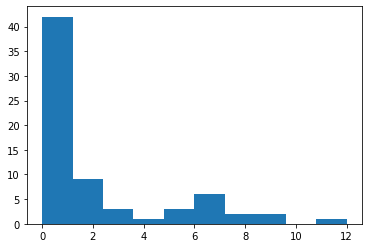

In [212]:
plt.hist([len(ec[2]) for ec in echoices])

(array([24.,  8., 10.,  4.,  5.,  6.,  3.,  1.,  1.,  1.]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ]),
 <BarContainer object of 10 artists>)

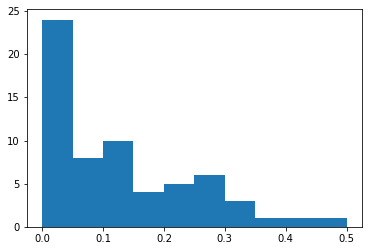

In [217]:
plt.hist([len(ec[2])/len(ct[2]) for (ec,ct) in zip(echoices, catch_trials) if len(ct[2])>0])

In [235]:
behavior_df[behavior_df.choice=='e'].index.values

array([218, 231, 253, 258, 291, 368], dtype=int64)

# QC the result using plots
- 230108_generate_qc_plots_for_dataset_merge.ipynb
- 230108_generate_qc_plots_for_dataset_merge.py (for parallel)

# Test codes

In [279]:
trial_num = 190
trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index] # end-to-end frame allocation
# First frame can be quite long, but there is no way that touch happened on the first frame
# whisker touch time
trial_whisker_series = whisker_df[whisker_df.index==trial_num]
trial_whisker_time = trial_whisker_series.whisker_time.values[0]

trial_kappaH = trial_whisker_series.kappaH.values[0]
trial_kappaV = trial_whisker_series.kappaV.values[0]
trial_phi = trial_whisker_series.phi.values[0]
trial_theta = trial_whisker_series.theta.values[0]
trial_arc_length = trial_whisker_series.arcLength.values[0]

trial_protraction_touch_chunks = trial_whisker_series.protractionTFchunksByWhisking.values[0]
trial_protraction_touch_chunks

[array([391., 392., 393., 394., 395., 396., 397., 398., 399., 400., 401.,
        402.]),
 array([446., 447., 448., 449.]),
 array([461., 462., 463., 464.]),
 array([475., 476., 477., 478.]),
 array([490., 491., 492.]),
 array([499., 500., 501., 502., 503., 504., 505., 506., 507., 508., 509.,
        510., 511., 512.]),
 array([533., 534., 535., 536., 537., 538., 539., 540., 541., 542., 543.,
        544., 545., 546., 547., 548., 549., 550., 551., 552.]),
 array([571., 572., 573., 574., 575., 576., 577., 578., 579., 580., 581.,
        582., 583., 584., 585., 586., 587., 588., 589., 590., 591., 592.,
        593., 594., 595., 596., 597., 598., 599., 600., 601., 602., 603.,
        604.]),
 array([634., 635., 636., 637., 638., 639., 640., 641., 642.]),
 array([650., 651., 652., 653., 654., 655., 656., 657., 658., 659., 660.,
        661., 662., 663., 664., 665., 666., 667., 668., 669., 670., 671.,
        672., 673., 674., 675., 676., 677.]),
 array([696., 697., 698.]),
 array([701., 70

In [280]:
touch_ind = 0
touch_chunk_whisker_index = trial_protraction_touch_chunks[touch_ind]
if np.ndim(touch_chunk_whisker_index) == 0:
    touch_chunk_whisker_index = np.asarray([touch_chunk_whisker_index])
touch_chunk_whisker_index = touch_chunk_whisker_index.astype(int)-1 # correcting 1-based MATLAB index to 0-based python index
touch_onset_time = trial_whisker_time[touch_chunk_whisker_index[0]]
touch_onset_2p_index = np.where(trial_2p_time>touch_onset_time)[0][0]

# Assign touch onset features
kappaH_first = trial_kappaH[touch_chunk_whisker_index[0]]
kappaV_first = trial_kappaV[touch_chunk_whisker_index[0]]
phi_first = trial_phi[touch_chunk_whisker_index[0]]
theta_first = trial_theta[touch_chunk_whisker_index[0]]

kappaH_onset[trial_2p_index[touch_onset_2p_index]] += kappaH_first
kappaV_onset[trial_2p_index[touch_onset_2p_index]] += kappaV_first
phi_onset[trial_2p_index[touch_onset_2p_index]] += phi_first
theta_onset[trial_2p_index[touch_onset_2p_index]] += theta_first

arc_length_onset[trial_2p_index[touch_onset_2p_index]] += trial_arc_length[touch_chunk_whisker_index[0]]
touch_count[trial_2p_index[touch_onset_2p_index]] += 1

# Assign during touch features
touch_offset_time = trial_whisker_time[touch_chunk_whisker_index[-1]]
touch_offset_2p_index = np.where(trial_2p_time>touch_offset_time)[0][0]
slide_distance_trial = trial_whisker_series.protractionSlideByWhisking.values[0][touch_ind]
if np.ndim(slide_distance_trial) == 0:
    slide_distance_trial = np.asarray([slide_distance_trial])

range(touch_onset_2p_index,touch_offset_2p_index+1)

IndexError: index 0 is out of bounds for axis 0 with size 0

In [282]:
trial_2p_time

array([], dtype=float64)

In [141]:
print(trial_2p_index[touch_onset_2p_index])

191


In [139]:
index_range = range(touch_onset_2p_index,touch_offset_2p_index+1)
index_ind = 0
touch_2p_index = index_range[index_ind]
touch_2p_index

21

In [140]:
current_2p_frame_end_time = trial_2p_time[touch_2p_index]
if trial_whisker_time[touch_chunk_whisker_index[-1]] > current_2p_frame_end_time: # when the current touch chunk ends later than the current 2p frame end time
    last_whisker_index_within_frame = np.where(trial_whisker_time[touch_chunk_whisker_index] > current_2p_frame_end_time)[0][0] # excluding this index
else:
    last_whisker_index_within_frame = len(touch_chunk_whisker_index) # excluding this index
if touch_2p_index == touch_onset_2p_index:
    first_whisker_index_within_frame = 0
else:
    last_2p_frame_end_time = trial_2p_time[touch_2p_index-1]
    first_whisker_index_within_frame = np.where(trial_whisker_time[touch_chunk_whisker_index] > last_2p_frame_end_time)[0][0]

print(first_whisker_index_within_frame)
print(last_whisker_index_within_frame)

0
4


In [ ]:
kappaH_within_frame = trial_kappaH[touch_chunk_whisker_index[first_whisker_index_within_frame:last_whisker_index_within_frame]]
delta_kappaH[trial_2p_index[touch_2p_index]] = np.amax(np.abs(kappaH_within_frame - kappaH_first)) * np.sign(kappaH_within_frame[np.argmax(np.abs(kappaH_within_frame - kappaH_first))] - kappaH_first)

kappaV_within_frame = trial_kappaV[touch_chunk_whisker_index[first_whisker_index_within_frame:last_whisker_index_within_frame]]
delta_kappaV[trial_2p_index[touch_2p_index]] = np.amax(np.abs(kappaV_within_frame - kappaV_first)) * np.sign(kappaV_within_frame[np.argmax(np.abs(kappaV_within_frame - kappaV_first))] - kappaV_first)

phi_within_frame = trial_phi[touch_chunk_whisker_index[first_whisker_index_within_frame:last_whisker_index_within_frame]]
delta_phi[trial_2p_index[touch_2p_index]] = np.amax(np.abs(phi_within_frame - phi_first)) * np.sign(phi_within_frame[np.argmax(np.abs(phi_within_frame - phi_first))] - phi_first)

theta_within_frame = trial_theta[touch_chunk_whisker_index[first_whisker_index_within_frame:last_whisker_index_within_frame]]
delta_theta[trial_2p_index[touch_2p_index]] = np.amax(np.abs(theta_within_frame - theta_first)) * np.sign(theta_within_frame[np.argmax(np.abs(theta_within_frame - theta_first))] - theta_first)

# Slide distance already calculated per whisker time frame, so only requires calculating max values within the frame
slide_distance_within_frame = slide_distance_trial[first_whisker_index_within_frame:last_whisker_index_within_frame]
slide_distance[trial_2p_index[touch_2p_index]] = np.amax(slide_distance_within_frame)

# Touch duration
touch_duration[trial_2p_index[touch_2p_index]] = trial_whisker_time[touch_chunk_whisker_index[last_whisker_index_within_frame-1]] - touch_onset_time

In [385]:
trial_ind = 30
trial_num = frame_time_df.trialNum.unique()[trial_ind]

trial_2p_index = np.where(frame_time_df.trialNum==trial_num)[0]
trial_2p_time = frame_time_df.frame_end_time.values[trial_2p_index] # end-to-end frame allocation

trial_behavior_series = behavior_df[behavior_df.index==trial_num]
pole_angle[trial_2p_index] = trial_behavior_series.servoAngle.values[0]
pole_ap_distance[trial_2p_index] = trial_behavior_series.motorApPosition.values[0]
pole_radial_distance[trial_2p_index] = trial_behavior_series.motorDistance.values[0]

lick_times = np.empty(0,)
left_lick_times = trial_behavior_series.beamBreakTimesLeft.values[0]
if np.size(left_lick_times)==1:
    left_lick_times = np.array([left_lick_times])    
right_lick_times = trial_behavior_series.beamBreakTimesRight.values[0]
if np.size(right_lick_times)==1:
    right_lick_times = np.array([right_lick_times])

if not ((np.size(left_lick_times)==2) and (np.array(left_lick_times==[0,1]).all())):
    lick_times = np.hstack((lick_times,left_lick_times))
    for left_lick_time in left_lick_times:
        if left_lick_time < trial_2p_time[-1]:
            left_lick_frame_ind = np.where(trial_2p_time > left_lick_time)[0][0]
            num_lick_left[trial_2p_index[left_lick_frame_ind]] += 1

if not ((np.size(right_lick_times)==2) and (np.array(right_lick_times==[0,1]).all())):
    lick_times = np.hstack((lick_times,right_lick_times))
    for right_lick_time in right_lick_times:
        if right_lick_time < trial_2p_time[-1]:
            right_lick_frame_ind = np.where(trial_2p_time > right_lick_time)[0][0]
            num_lick_right[trial_2p_index[right_lick_frame_ind]] += 1

if len(lick_times) > 0:
    first_lick_time = np.amin(lick_times)
    if first_lick_time < trial_2p_time[-1]:
        first_lick_ind = np.where(trial_2p_time > first_lick_time)[0][0]
        first_lick_frame[trial_2p_index[first_lick_ind]] = 1
        if first_lick_time in left_lick_times:
            first_lick_left[trial_2p_index[first_lick_ind]] = 1
        elif first_lick_time in right_lick_times:
            first_lick_right[trial_2p_index[first_lick_ind]] = 1
        else:
            raise('First lick should be in either left or right beam break times')

if np.size(trial_behavior_series.answerLickTime) == 1: # answer trial
    answer_lick_time = trial_behavior_series.answerLickTime.values[0]        
    answer_lick_frame_ind = np.where(trial_2p_time > answer_lick_time)[0][0]
    answer_lick_frame[trial_2p_index[answer_lick_frame_ind]] == 1
    if answer_lick_time in left_lick_times:
        answer_lick_left[trial_2p_index[answer_lick_frame_ind]] = 1
    elif answer_lick_time in right_lick_times:
        answer_lick_right[trial_2p_index[answer_lick_frame_ind]] = 1
    else:
        raise('Answer lick should be in either left or right beam break times')
    
    if not np.array(trial_behavior_series.drinkingTime==[0,0]).all(): # correct trial
        correct[trial_2p_index] = 1
        if answer_lick_time in left_lick_times: # left trial
            first_reward_lick_time = left_lick_times[np.where(left_lick_times > answer_lick_time)[0][0]]
            first_reward_lick_frame_ind = np.where(trial_2p_time > first_reward_lick_time)[0][0]
            first_reward_lick_frame[trial_2p_index[first_reward_lick_frame_ind]] = 1
            first_reward_lick_left[trial_2p_index[first_reward_lick_frame_ind]] = 1
        else: # right trial. Exception error dealt above
            first_reward_lick_time = right_lick_times[np.where(right_lick_times > answer_lick_time)[0][0]]
            first_reward_lick_frame_ind = np.where(trial_2p_time > first_reward_lick_time)[0][0]
            first_reward_lick_frame[trial_2p_index[first_reward_lick_frame_ind]] = 1
            first_reward_lick_right[trial_2p_index[first_reward_lick_frame_ind]] = 1
    else:
        wrong[trial_2p_index] = 1
    
    trial_pole_up_frame = frame_time_df.pole_up_frame.values[trial_2p_index]
    trial_pre_answer_frame = np.zeros(len(trial_pole_up_frame), dtype=bool)
    trial_pre_answer_frame[:answer_lick_frame_ind] = 1
    pre_answer_pole_up_frame[trial_2p_index] = trial_pole_up_frame * trial_pre_answer_frame
    trial_post_answer_frame = np.zeros(len(trial_pole_up_frame), dtype=bool)
    trial_post_answer_frame[answer_lick_frame_ind+1:] = 1
    post_answer_pole_up_frame[trial_2p_index] = trial_pole_up_frame * trial_post_answer_frame
    
else:
    miss[trial_2p_index] = 1

answer_period_time = trial_behavior_series.answerPeriodTime.values[0]
answer_period_frame_first_ind = np.where(trial_2p_time > answer_period_time[0])[0][0]
answer_period_frame_last_ind = np.where(trial_2p_time > answer_period_time[1])[0][0]
answer_period_frame[trial_2p_index[answer_period_frame_first_ind:answer_period_frame_last_ind+1]] = 1

In [386]:
np.size(behavior_df.iloc[i].answerLickTime)

2

# NaN error in trialNum

In [ ]:
mouse=25
session_num =6
plane = 1

if session_num > 900:
    wb_snum = session_num // 10 + session_num % 900 # pre1 is 901 in calcium but 91 in behavior and whisker
else:
    wb_snum = session_num
# Load whisker
w_path = w_dir / f'JK{mouse:03d}S{wb_snum:02d}' / f'JK{mouse:03d}S{wb_snum:02d}_whisker.pkl'
whisker_df = pd.read_pickle(w_path)
# Load behavior
b_path = b_dir / f'JK{mouse:03d}' / f'JK{mouse:03d}S{wb_snum:02d}_behavior.pkl'
behavior_df = pd.read_pickle(b_path)
# Load frame times
tf_path = h5_dir / f'{mouse:03d}' / f'plane_{plane}' / f'{mouse:03d}_{session_num:03d}_plane_{plane}_frame_time.pkl'
frame_time_df = pd.read_pickle(tf_path)

In [ ]:
np.where(frame_time_df.trialNum.apply(lambda x: np.isnan(x)))

(array([5293, 5294, 5295, ..., 7699, 7700, 7701], dtype=int64),)

In [ ]:
frame_time_df.trialNum.unique()

array([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
       21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37,
       38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 202, 203, 204, 205,
       206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218,
       219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231,
       232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244,
       245, 246, 247, 248, 249, 250, 251, nan], dtype=object)

In [ ]:
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
ophys_trial_fn_list

['H:\\025\\025_006_000.trials']

In [ ]:
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
for fn in ophys_trial_fn_list:
    ophys_trial = loadmat(fn, simplify_cells=True)

In [ ]:
ophys_trial

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Thu Dec 10 18:05:31 2020',
 '__version__': '1.0',
 '__globals__': [],
 'fn': 'E:\\025\\025_006_000',
 'varargin': array([], dtype=object),
 'laserOffIncluded': 0,
 'a': array([[ 1737,  1600,  1310, ...,  1795,  1681,  1482],
        [65535, 65535, 65535, ...,  1351,  1645,   964],
        [ 1336,  1635,  1376, ...,  1267,  1280,  1649],
        ...,
        [65535, 65535, 65535, ..., 11696,  6206,  1246],
        [ 1153,  7134,  1565, ..., 13885,  3095,  1467],
        [65535, 65535, 65535, ...,  5139,  1878,  5870]], dtype=uint16),
 'layer_trials': array([array([  2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
                15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
                28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,
                41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51, 102, 103,
               104, 105, 106, 107, 108, 109, 110, 111, 1

In [ ]:
ophys_trials = np.array([x['trialnum'] for x in ophys_trial['trials']])
nan_inds = np.where([np.isnan(x) for x in ophys_trials])[0]
nan_inds
for ni in nan_inds:
    print(ophys_trials[[ni-1, ni, ni+1]])

[271.  nan 273.]


In [ ]:
expert_mice_ind = [0,1,2,3,6,8]

# for emi in range(3):
emi = 0
mi = expert_mice_ind[emi]
if emi < 3:
    h5_dir = h5_dir_1
else:
    h5_dir = h5_dir_2
mouse = mice[mi]
image_rate = image_rate_list[mi]
image_size = image_size_list[mi]

# for top_plane_ind in [0,4]:
top_plane_ind = 4

plane = planes[top_plane_ind]
plane_dir = h5_dir / f'{mouse:03d}' / f'plane_{plane}'
sts_reg = np.load(plane_dir / f'JK{mouse:03d}_plane{plane}_session_to_session_registration.npy', allow_pickle=True).item()
session_nums = sts_reg['selected_session_num']
# This info is valid in pi:pi+4

# for session_num in session_nums:
session_num = 6

trial_start_end = []
plane_frames = [[],[],[],[]] # 4 planes per volume
ophys_trial_fn_list = glob.glob(str(h5_dir / f'{mouse:03d}' / f'{mouse:03d}_{session_num:03d}_0*.trials')) # sometimes there are multiple trials files because of random scanbox stoppage error
for fn in ophys_trial_fn_list:
    ophys_trial = loadmat(fn, simplify_cells=True)
    trial_start_end.extend(ophys_trial['trials'])
    for pi in range(4):
        plane_frames[pi].extend(ophys_trial['frame_to_use'][top_plane_ind+pi])

plane_df_list = [pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']), # trial_duration for trial length QC
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index']),
                pd.DataFrame(columns=['trialNum', 'frame_start_time', 'frame_end_time', 'trial_duration', 'frame_index'])]
for trial in trial_start_end:
    trial_num = trial['trialnum']
    if np.isfinite(trial_num): # there was a case where trialnum was NaN, and corresponding frames were > 2000 frames in len
        # Happened only in 025_006_000.trials (d230104_trial_num_nan_check.m)
        # Not checked for non-experts.
        # Add frame index (index of frame_to_use)
        # Does not need to remove corresponding frames from calcium data, because frame_to_use were collected by matching 'trialnum', so
        # 'NaN' trialnum were not assigned.
        # Thus, total # of rows in the dataframe matches to the last frame index.
        trial_start_frame = trial['frames'][0]
        trial_end_frame = trial['frames'][1]
        trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
        trial_end_line = trial['lines'][1]
        # Find indice for this trial from the plane
        plane_frame_inds_trial = []
        for pi in range(4):
            plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
        len_frames = np.array([len(f) for f in plane_frame_inds_trial])
        assert (len_frames[1:] - len_frames[0]).any() == False # to confirm that each plane shared the same # of frames

        # Make per trial DataFrame in each plane
        for pi in range(4):
            # Calculate start and end time for each frame
            plane_frame_trial = np.asarray(plane_frames[pi])[plane_frame_inds_trial[pi]]
            start_tmp = list((plane_frame_trial - trial_start_frame + (trial_start_line - 1) / image_size[0]) / image_rate)
            end_tmp = list((plane_frame_trial - trial_start_frame + 1 + (trial_start_line - 1) / image_size[0]) / image_rate) #
                # end_time should include the end of the last line 
                # It matches to the next frame (next plane) start time
                # TTL signal is assumed to have arrived at the beginning of the line
            trial_df_tmp = pd.DataFrame()
            trial_df_tmp['frame_start_time'] = start_tmp
            trial_df_tmp['frame_end_time'] = end_tmp
            trial_df_tmp['trialNum'] = trial_num
            # Calculate trial duration
            trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
            trial_df_tmp['trial_duration'] = trial_duration
            trial_df_tmp['frame_index'] = plane_frame_inds_trial[pi]

            plane_df_list[pi] = plane_df_list[pi].append(trial_df_tmp)

C:\Users\shires\AppData\Local\Temp/ipykernel_36912/2199620921.py:71: RuntimeWarning: overflow encountered in ushort_scalars
  trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate
C:\Users\shires\AppData\Local\Temp/ipykernel_36912/2199620921.py:71: RuntimeWarning: overflow encountered in ubyte_scalars
  trial_duration = (trial_end_frame - trial_start_frame + (trial_end_line - trial_start_line) / image_size[0]) / image_rate


In [ ]:
mouse

25

In [ ]:
session_num

6

In [ ]:
ophys_trial

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Thu Dec 10 18:05:31 2020',
 '__version__': '1.0',
 '__globals__': [],
 'fn': 'E:\\025\\025_006_000',
 'varargin': array([], dtype=object),
 'laserOffIncluded': 0,
 'a': array([[ 1737,  1600,  1310, ...,  1795,  1681,  1482],
        [65535, 65535, 65535, ...,  1351,  1645,   964],
        [ 1336,  1635,  1376, ...,  1267,  1280,  1649],
        ...,
        [65535, 65535, 65535, ..., 11696,  6206,  1246],
        [ 1153,  7134,  1565, ..., 13885,  3095,  1467],
        [65535, 65535, 65535, ...,  5139,  1878,  5870]], dtype=uint16),
 'layer_trials': array([array([  2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
                15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
                28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,
                41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51, 102, 103,
               104, 105, 106, 107, 108, 109, 110, 111, 1

In [ ]:
ophys_trial['frame_to_use']

array([array([  203,   207,   211, ..., 53551, 53555, 53559], dtype=uint16),
       array([  202,   206,   210, ..., 53550, 53554, 53558], dtype=uint16),
       array([  201,   205,   209, ..., 53549, 53553, 53557], dtype=uint16),
       array([  200,   204,   208, ..., 53548, 53552, 53556], dtype=uint16),
       array([10927, 10931, 10935, ..., 64343, 64347, 64351], dtype=uint16),
       array([10926, 10930, 10934, ..., 64342, 64346, 64350], dtype=uint16),
       array([10925, 10929, 10933, ..., 64341, 64345, 64349], dtype=uint16),
       array([10924, 10928, 10932, ..., 64340, 64344, 64348], dtype=uint16)],
      dtype=object)

In [ ]:
plane

5

In [ ]:
trial = trial_start_end[0]
trial_start_frame = trial['frames'][0]
trial_end_frame = trial['frames'][1]
trial_start_line = trial['lines'][0] # 1-based index from MATLAB, not 0-based index
trial_end_line = trial['lines'][1]
# Find indice for this trial from the plane
plane_frame_inds_trial = []
for pi in range(4):
    plane_frame_inds_trial.append(np.where((plane_frames[pi] >= trial['frames'][0]) & (plane_frames[pi] <= trial['frames'][1]))[0].astype(int))
len_frames = np.array([len(f) for f in plane_frame_inds_trial])

In [ ]:
ophys_trial['frame_to_use']

array([array([  203,   207,   211, ..., 53551, 53555, 53559], dtype=uint16),
       array([  202,   206,   210, ..., 53550, 53554, 53558], dtype=uint16),
       array([  201,   205,   209, ..., 53549, 53553, 53557], dtype=uint16),
       array([  200,   204,   208, ..., 53548, 53552, 53556], dtype=uint16),
       array([10927, 10931, 10935, ..., 64343, 64347, 64351], dtype=uint16),
       array([10926, 10930, 10934, ..., 64342, 64346, 64350], dtype=uint16),
       array([10925, 10929, 10933, ..., 64341, 64345, 64349], dtype=uint16),
       array([10924, 10928, 10932, ..., 64340, 64344, 64348], dtype=uint16)],
      dtype=object)

In [ ]:
ophys_trials = np.array([x['trialnum'] for x in ophys_trial['trials']])
nan_inds = np.where([np.isnan(x) for x in ophys_trials])[0]
nan_inds
for ni in nan_inds:
    print(ophys_trials[[ni-1, ni, ni+1]])

[271.  nan 273.]


In [ ]:
ophys_trial['layer_trials']

array([array([  2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
               15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
               28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,
               41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51, 102, 103,
              104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
              117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
              130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
              143, 144, 145, 146, 147, 148, 149, 150, 151, 202, 203, 204, 205,
              206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218,
              219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231,
              232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244,
              245, 246, 247, 248, 249, 250, 251], dtype=uint8)                ,
       array([ 52,  53,  54,  55,  56,  57,  58,  5

In [ ]:
ophys_trial['trials'][269]

{'trialnum': 271,
 'frames': array([58019, 58196], dtype=uint16),
 'lines': array([283, 203], dtype=uint16)}

In [ ]:
ophys_trial['trials'][270]

{'trialnum': nan,
 'frames': array([28163, 58454], dtype=uint16),
 'lines': array([403, 479], dtype=uint16)}

In [ ]:
ophys_trial['trials'][271]

{'trialnum': 273,
 'frames': array([58522, 58702], dtype=uint16),
 'lines': array([94, 57], dtype=uint8)}

In [ ]:
np.intersect1d(np.where(ophys_trial['frame_to_use'][5]>58196)[0], np.where(ophys_trial['frame_to_use'][5]<58522)[0])

array([], dtype=int64)

In [ ]:
plane_df_list[0].trialNum.unique()

array([52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101,
       152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164,
       165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177,
       178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190,
       191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 252, 253,
       254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266,
       267, 268, 269, 270, 271, 273, 274, 275, 276, 277, 278, 279, 280,
       281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293,
       294, 295], dtype=object)

In [ ]:
plane_df_list[0][plane_df_list[0].trialNum==270]

,trialNum,frame_start_time,frame_end_time,trial_duration,frame_index
0,270,0.242653,0.275083,5.714854,4103
1,270,0.372372,0.404802,5.714854,4104
2,270,0.502091,0.534521,5.714854,4105
3,270,0.631810,0.664239,5.714854,4106
4,270,0.761529,0.793958,5.714854,4107
5,270,0.891248,0.923677,5.714854,4108
6,270,1.020967,1.053396,5.714854,4109
7,270,1.150685,1.183115,5.714854,4110
8,270,1.280404,1.312834,5.714854,4111
9,270,1.410123,1.442553,5.714854,4112


In [ ]:
plane_df_list[0][plane_df_list[0].trialNum==271]

,trialNum,frame_start_time,frame_end_time,trial_duration,frame_index
0,271,0.147581,0.180010,9.886001,4146
1,271,0.277300,0.309729,9.886001,4147
2,271,0.407018,0.439448,9.886001,4148
3,271,0.536737,0.569167,9.886001,4149
4,271,0.666456,0.698886,9.886001,4150
5,271,0.796175,0.828605,9.886001,4151
6,271,0.925894,0.958324,9.886001,4152
7,271,1.055613,1.088043,9.886001,4153
8,271,1.185332,1.217762,9.886001,4154
9,271,1.315051,1.347481,9.886001,4155


In [ ]:
plane_df_list[0][plane_df_list[0].trialNum==273]

,trialNum,frame_start_time,frame_end_time,trial_duration,frame_index
0,273,0.168039,0.200469,5.851223,4190
1,273,0.297758,0.330188,5.851223,4191
2,273,0.427477,0.459907,5.851223,4192
3,273,0.557196,0.589626,5.851223,4193
4,273,0.686915,0.719345,5.851223,4194
5,273,0.816634,0.849064,5.851223,4195
6,273,0.946353,0.978783,5.851223,4196
7,273,1.076072,1.108501,5.851223,4197
8,273,1.205791,1.238220,5.851223,4198
9,273,1.335510,1.367939,5.851223,4199


In [ ]:
plane_df_list[0]

,trialNum,frame_start_time,frame_end_time,trial_duration,frame_index
0,52,0.210983,0.243413,10.234748,0
1,52,0.340702,0.373132,10.234748,1
2,52,0.470421,0.502851,10.234748,2
3,52,0.600140,0.632570,10.234748,3
4,52,0.729859,0.762289,10.234748,4
...,...,...,...,...,...
41,295,5.525406,5.557835,6.099703,5197
42,295,5.655125,5.687554,6.099703,5198
43,295,5.784844,5.817273,6.099703,5199
44,295,5.914563,5.946992,6.099703,5200


In [ ]:
len(np.where([np.isnan(x) for x in plane_df_list[pi].trialNum.values])[0])

2409

In [ ]:
trial_num

295

In [ ]:
trial_df_tmp

,frame_start_time,frame_end_time,trialNum,trial_duration,frame_index
